# Data Cleaning/EDA

### **Dataset 1: Coffee Shop Sales data (noelle)**
https://www.kaggle.com/datasets/ahmedabbas757/coffee-sales

### **data preprocessing**

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
from google.colab import files
files.upload()

Saving Coffee Shop Sales.xlsx to Coffee Shop Sales (3).xlsx


{'Coffee Shop Sales (3).xlsx': b'PK\x03\x04\x14\x00\x06\x00\x08\x00\x00\x00!\x00e\xdf\x92\xdcl\x01\x00\x00\xc4\x04\x00\x00\x13\x00\x08\x02[Content_Types].xml \xa2\x04\x02(\xa0\x00\x02\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\

In [ ]:
data = pd.read_excel("Coffee Shop Sales.xlsx")
data.head()

,transaction_id,transaction_date,transaction_time,transaction_qty,store_id,store_location,product_id,unit_price,product_category,product_type,product_detail
0,1,2023-01-01,07:06:11,2,5,Lower Manhattan,32,3.0,Coffee,Gourmet brewed coffee,Ethiopia Rg
1,2,2023-01-01,07:08:56,2,5,Lower Manhattan,57,3.1,Tea,Brewed Chai tea,Spicy Eye Opener Chai Lg
2,3,2023-01-01,07:14:04,2,5,Lower Manhattan,59,4.5,Drinking Chocolate,Hot chocolate,Dark chocolate Lg
3,4,2023-01-01,07:20:24,1,5,Lower Manhattan,22,2.0,Coffee,Drip coffee,Our Old Time Diner Blend Sm
4,5,2023-01-01,07:22:41,2,5,Lower Manhattan,57,3.1,Tea,Brewed Chai tea,Spicy Eye Opener Chai Lg


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149116 entries, 0 to 149115
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   transaction_id    149116 non-null  int64         
 1   transaction_date  149116 non-null  datetime64[ns]
 2   transaction_time  149116 non-null  object        
 3   transaction_qty   149116 non-null  int64         
 4   store_id          149116 non-null  int64         
 5   store_location    149116 non-null  object        
 6   product_id        149116 non-null  int64         
 7   unit_price        149116 non-null  float64       
 8   product_category  149116 non-null  object        
 9   product_type      149116 non-null  object        
 10  product_detail    149116 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(4), object(5)
memory usage: 12.5+ MB


In [ ]:
data.isnull().sum()

,0
transaction_id,0
transaction_date,0
transaction_time,0
transaction_qty,0
store_id,0
store_location,0
product_id,0
unit_price,0
product_category,0
product_type,0


In [ ]:
data.describe()

,transaction_id,transaction_date,transaction_qty,store_id,product_id,unit_price
count,149116.000000,149116,149116.000000,149116.000000,149116.000000,149116.000000
mean,74737.371872,2023-04-15 11:50:32.173609984,1.438276,5.342063,47.918607,3.382219
min,1.000000,2023-01-01 00:00:00,1.000000,3.000000,1.000000,0.800000
25%,37335.750000,2023-03-06 00:00:00,1.000000,3.000000,33.000000,2.500000
50%,74727.500000,2023-04-24 00:00:00,1.000000,5.000000,47.000000,3.000000
75%,112094.250000,2023-05-30 00:00:00,2.000000,8.000000,60.000000,3.750000
max,149456.000000,2023-06-30 00:00:00,8.000000,8.000000,87.000000,45.000000
std,43153.600016,NaN,0.542509,2.074241,17.930020,2.658723


In [ ]:
data.describe(include=object)

,transaction_time,store_location,product_category,product_type,product_detail
count,149116,149116,149116,149116,149116
unique,25762,3,9,29,80
top,09:31:15,Hell's Kitchen,Coffee,Brewed Chai tea,Chocolate Croissant
freq,41,50735,58416,17183,3076


In [ ]:
data['day'] = data['transaction_date'].dt.day_name()
data['month'] = data['transaction_date'].dt.month_name()
data['year'] = data['transaction_date'].dt.year
data['hour_of_purchase'] = pd.to_datetime(data['transaction_time'], format='%H:%M:%S').dt.hour

In [ ]:
data.drop(columns = ["transaction_date", "product_id", "store_id", "transaction_id", "transaction_time"], inplace=True)

In [ ]:
str_cols = data.select_dtypes(include="object").columns

for col in str_cols:
  data[col] = data[col].str.lower()

In [ ]:
def seasons(month):
  if month in ['december', 'january', 'february']:
        return 'winter'
  elif month in ['march', 'april', 'may']:
      return 'spring'
  elif month in ['june', 'july', 'august']:
      return 'summer'
  else:
      return 'fall'

data['season'] = data['month'].apply(seasons)

In [ ]:
data["total_revenue"] = data["transaction_qty"] * data["unit_price"]

In [ ]:
data.head()

,transaction_qty,store_location,unit_price,product_category,product_type,product_detail,day,month,year,hour_of_purchase,season,total_revenue
0,2,lower manhattan,3.0,coffee,gourmet brewed coffee,ethiopia rg,sunday,january,2023,7,winter,6.0
1,2,lower manhattan,3.1,tea,brewed chai tea,spicy eye opener chai lg,sunday,january,2023,7,winter,6.2
2,2,lower manhattan,4.5,drinking chocolate,hot chocolate,dark chocolate lg,sunday,january,2023,7,winter,9.0
3,1,lower manhattan,2.0,coffee,drip coffee,our old time diner blend sm,sunday,january,2023,7,winter,2.0
4,2,lower manhattan,3.1,tea,brewed chai tea,spicy eye opener chai lg,sunday,january,2023,7,winter,6.2


In [ ]:
data.to_csv("cleaned_coffee_shop_sales.csv", index=False)

files.download("cleaned_coffee_shop_sales.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### preprocessing steps

1. Imported the Coffee shop sales dataset using pd.read_excel(), and then explored the dataset's information using .info(), .describe(), and isnull(). This helped to check for any missing values in the data, along with the data types of each column and statistical summaries for both object type and numerical type columns.
2. The original dataset had both the specific date and time of a transaction. To make analysis simpler, dt accessors were used to extract the day of the week, month name and year from the initial "transaction_date" column. The time of purchase was also converted to Datetime object before extracting the hour using dt.hour.
3. All string values in columns were converted to lowercase to maintain consistency
4. Any duplicated/not relevant columns for modelling or further analysis were dropped, for example timestamps, full dates of purchase, and store identifiers.

#### data formatting
Initially, dates and timings were converted to Datetime object for easier analysis such as extraction of day, hour, month etc. Additionally, any redundant IDs and time columns were removed to clear the dataset. All text data was changed to lowercase for consistency and standardization for later modelling/grouping.

#### data dictionary

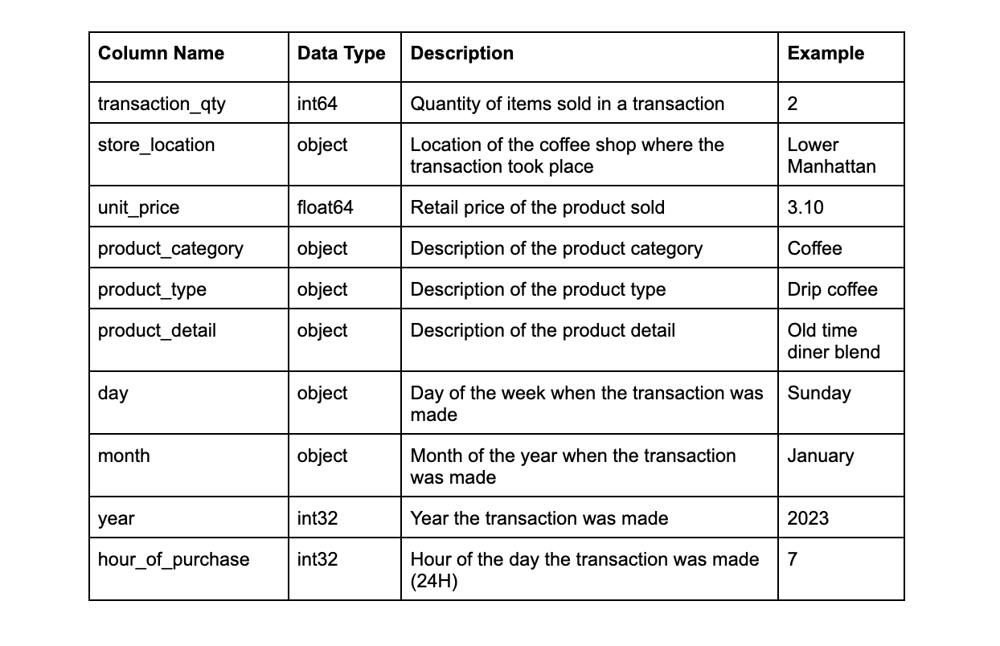

#### **EDA**

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

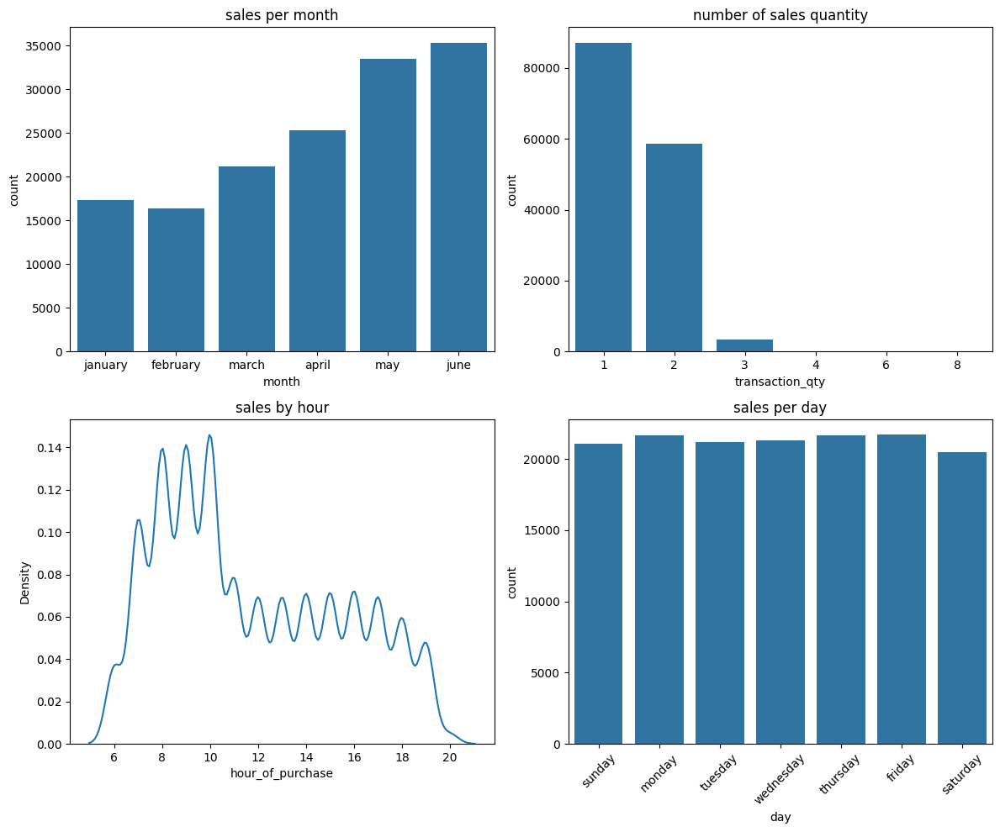

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(12,10))
sns.countplot(data=data, x="month", ax=axes[0,0])
axes[0,0].set_title("sales per month")

sns.countplot(data=data, x="day", ax=axes[1,1])
axes[1,1].set_title("sales per day")
axes[1, 1].tick_params(axis='x', rotation=45)

sns.kdeplot(data["hour_of_purchase"], ax=axes[1,0])
axes[1,0].set_title("sales by hour")

sns.countplot(data=data, x="transaction_qty", ax=axes[0,1])
axes[0,1].set_title("number of sales quantity")

plt.tight_layout()
plt.show()

<Axes: xlabel='product_category', ylabel='count'>

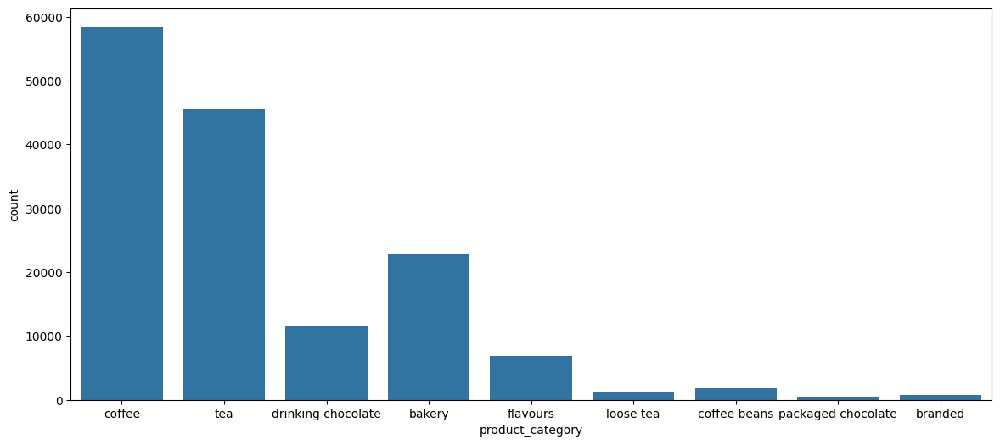

In [ ]:
plt.figure(figsize=(14, 6))
sns.countplot(data=data, x="product_category")

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
 [Text(0, 0, 'brewed chai tea'),
  Text(1, 0, 'gourmet brewed coffee'),
  Text(2, 0, 'barista espresso'),
  Text(3, 0, 'hot chocolate'),
  Text(4, 0, 'brewed black tea'),
  Text(5, 0, 'brewed herbal tea'),
  Text(6, 0, 'scone'),
  Text(7, 0, 'organic brewed coffee'),
  Text(8, 0, 'drip coffee'),
  Text(9, 0, 'premium brewed coffee')])

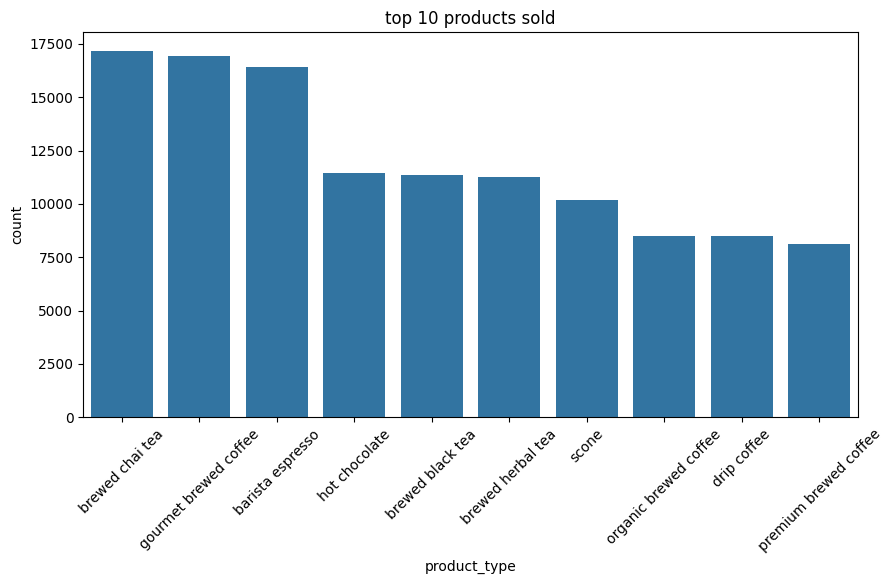

In [ ]:
top_products = data['product_type'].value_counts().nlargest(10).reset_index()
top_products.columns = ['product_type', 'count']

plt.figure(figsize=(10, 5))
sns.barplot(data=top_products, x='product_type', y='count')
plt.title("top 10 products sold")
plt.xticks(rotation=45)

<Axes: xlabel='transaction_qty', ylabel='total_revenue'>

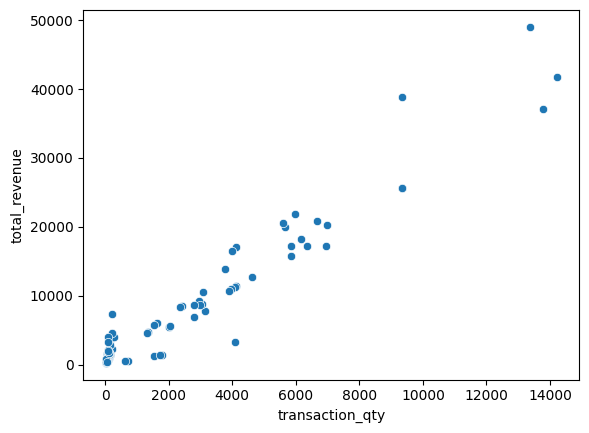

In [ ]:
summary = data.groupby(["season", "product_type"]).agg({
    "transaction_qty": "sum",
    "total_revenue": "sum"
}).reset_index()

sns.scatterplot(data=summary, x="transaction_qty", y="total_revenue")

In [ ]:
sorted_summary = (summary[["product_type", "transaction_qty", "total_revenue", "season"]]).sort_values(by="total_revenue", ascending=False)
sorted_summary

,product_type,transaction_qty,total_revenue,season
0,barista espresso,13370,49057.85,spring
4,brewed chai tea,14212,41748.95,spring
17,hot chocolate,9357,38840.00,spring
13,gourmet brewed coffee,13771,37168.80,spring
3,brewed black tea,9358,25676.50,spring
...,...,...,...,...
80,organic chocolate,50,380.00,winter
51,organic chocolate,50,380.00,summer
73,green tea,37,342.25,winter
44,green tea,36,333.00,summer


/tmp/ipython-input-531113912.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  monthly_revenue = data.groupby("month")["total_revenue"].sum().reset_index()


<Axes: xlabel='month', ylabel='total_revenue'>

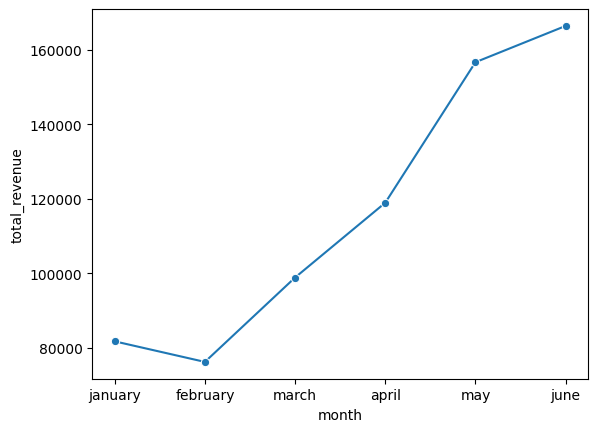

In [ ]:
months = ["january", "february", "march", "april", "may", "june"]
data["month"] = pd.Categorical(data["month"], categories=months)

monthly_revenue = data.groupby("month")["total_revenue"].sum().reset_index()
sns.lineplot(data=monthly_revenue, x="month", y="total_revenue", marker= "o")

<Axes: xlabel='month', ylabel='count'>

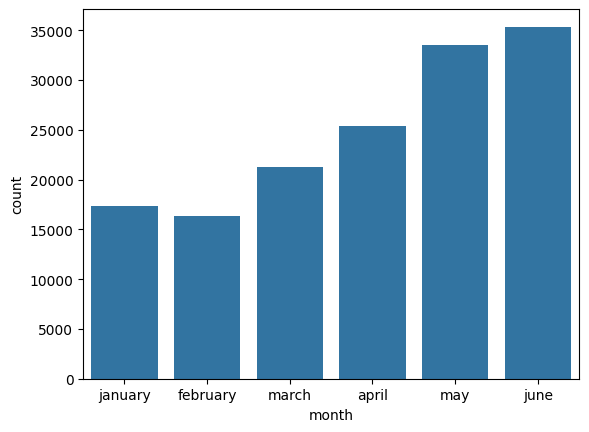

In [ ]:
sns.countplot(data=data, x="month")

### Dataset 2: coffee shop sample data (Phoebe)
https://www.kaggle.com/datasets/ylchang/coffee-shop-sample-data-1113?select=customer.csv

In [ ]:
from google.colab import files
files.upload()


Saving 201904 sales reciepts.csv to 201904 sales reciepts (1).csv
Saving staff.csv to staff.csv
Saving sales_outlet.csv to sales_outlet.csv
Saving sales targets.csv to sales targets.csv
Saving product (1).csv to product (1) (1).csv
Saving pastry inventory.csv to pastry inventory.csv
Saving generations.csv to generations.csv
Saving customer (1).csv to customer (1) (1).csv
Saving Dates.csv to Dates.csv


{'201904 sales reciepts (1).csv': b'"transaction_id","transaction_date","transaction_time","sales_outlet_id","staff_id","customer_id","instore_yn","order","line_item_id","product_id","quantity","line_item_amount","unit_price","promo_item_yn"\r\n7,2019-04-01,12:04:43,3,12,558,N,1,1,52,1,2.50,2.50,N\r\n11,2019-04-01,15:54:39,3,17,781,N,1,1,27,2,7.00,3.50,N\r\n19,2019-04-01,14:34:59,3,17,788,Y,1,1,46,2,5.00,2.50,N\r\n32,2019-04-01,16:06:04,3,12,683,N,1,1,23,2,5.00,2.50,N\r\n33,2019-04-01,19:18:37,3,17,99,Y,1,1,34,1,2.45,2.45,N\r\n39,2019-04-01,18:54:46,3,17,664,Y,1,1,32,1,3.00,3.00,N\r\n50,2019-04-01,13:03:49,3,12,316,N,1,1,49,2,6.00,3.00,N\r\n53,2019-04-01,11:21:14,3,12,38,N,1,1,60,1,3.75,3.75,N\r\n59,2019-04-01,19:30:55,3,12,370,Y,1,1,51,2,6.00,3.00,N\r\n62,2019-04-01,12:01:00,3,12,180,Y,1,1,49,2,6.00,3.00,N\r\n81,2019-04-01,13:20:51,3,12,35,Y,1,1,35,2,6.20,3.10,N\r\n90,2019-04-01,11:40:20,3,17,595,N,1,1,47,1,3.00,3.00,N\r\n91,2019-04-01,12:27:43,3,12,500,N,1,1,25,2,4.40,2.20,N\r\n94,20

In [ ]:
import pandas as pd


In [ ]:
staff = pd.read_csv('staff.csv')

# Drop empty columns
staff.drop(['Unnamed: 6', 'Unnamed: 7'], axis=1, inplace=True)

# Convert start_date to datetime
staff['start_date'] = pd.to_datetime(staff['start_date'])

# Save cleaned
staff.to_csv('staff_clean.csv', index=False)
staff.head()


,staff_id,first_name,last_name,position,start_date,location
0,1,Sue,Tindale,CFO,2001-08-03,HQ
1,2,Ian,Tindale,CEO,2001-08-03,HQ
2,3,Marny,Hermione,Roaster,2007-10-24,WH
3,4,Chelsea,Claudia,Roaster,2003-07-03,WH
4,5,Alec,Isadora,Roaster,2008-04-02,WH


In [ ]:
sales_outlet = pd.read_csv('sales_outlet.csv')

# Rename typo column
sales_outlet.rename(columns={'Neighorhood': 'Neighborhood'}, inplace=True)

# Fill missing manager with 'Unknown'
sales_outlet['manager'].fillna('Unknown', inplace=True)

# Save cleaned
sales_outlet.to_csv('sales_outlet_clean.csv', index=False)
sales_outlet.head()


/tmp/ipython-input-2238641707.py:7: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  sales_outlet['manager'].fillna('Unknown', inplace=True)
/tmp/ipython-input-2238641707.py:7: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Unknown' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  sales_outlet['manager'].fillna('Unknown', inplace=True)


,sales_outlet_id,sales_outlet_type,store_square_feet,store_address,store_city,store_state_province,store_telephone,store_postal_code,store_longitude,store_latitude,manager,Neighborhood
0,2,warehouse,3400,164-14 Jamaica Ave,Jamaica,NY,972-871-0402,11432,-73.795168,40.705226,Unknown,Jamaica
1,3,retail,1300,32-20 Broadway,Long Island City,NY,777-718-3190,11106,-73.924008,40.761196,6.0,Astoria
2,4,retail,1300,604 Union Street,Brooklyn,NY,619-347-5193,11215,-73.983984,40.677645,11.0,Gowanus
3,5,retail,900,100 Church Street,New York,NY,343-212-5151,10007,-74.010130,40.713290,16.0,Lower Manhattan
4,6,retail,1000,122 E Broadway,New York,NY,613-555-4989,10002,-73.992687,40.713852,21.0,Lower East Side


In [ ]:
sales_targets = pd.read_csv('sales targets.csv')

# Rename column
sales_targets.rename(columns={'merchandise _goal': 'merchandise_goal'}, inplace=True)

# Save cleaned
sales_targets.to_csv('sales_targets_clean.csv', index=False)
sales_targets.head()


,sales_outlet_id,year_month,beans_goal,beverage_goal,food_goal,merchandise_goal,total_goal
0,3,Apr-19,720,13500,3420,360,18000
1,4,Apr-19,720,13500,3420,360,18000
2,5,Apr-19,1000,18750,4750,500,25000
3,6,Apr-19,720,13500,3420,360,18000
4,7,Apr-19,720,13500,3420,360,18000


In [ ]:
product = pd.read_csv('product.csv')

# Remove $ and convert to float
product['current_retail_price'] = product['current_retail_price'].replace('[\$,]', '', regex=True).astype(float)

# Save cleaned
product.to_csv('product_clean.csv', index=False)
product.head()


,product_id,product_group,product_category,product_type,product,product_description,unit_of_measure,current_wholesale_price,current_retail_price,tax_exempt_yn,promo_yn,new_product_yn
0,1,Whole Bean/Teas,Coffee beans,Organic Beans,Brazilian - Organic,It's like Carnival in a cup. Clean and smooth.,12 oz,14.40,18.00,Y,N,N
1,2,Whole Bean/Teas,Coffee beans,House blend Beans,Our Old Time Diner Blend,Out packed blend of beans that is reminiscent ...,12 oz,14.40,18.00,Y,N,N
2,3,Whole Bean/Teas,Coffee beans,Espresso Beans,Espresso Roast,Our house blend for a good espresso shot.,1 lb,11.80,14.75,Y,N,N
3,4,Whole Bean/Teas,Coffee beans,Espresso Beans,Primo Espresso Roast,Our primium single source of hand roasted beans.,1 lb,16.36,20.45,Y,N,N
4,5,Whole Bean/Teas,Coffee beans,Gourmet Beans,Columbian Medium Roast,A smooth cup of coffee any time of day.,1 lb,12.00,15.00,Y,N,N


In [ ]:
pastry_inventory = pd.read_csv('pastry inventory.csv')

# Convert dates and % waste
pastry_inventory['transaction_date'] = pd.to_datetime(pastry_inventory['transaction_date'])
pastry_inventory['% waste'] = pastry_inventory['% waste'].str.replace('%', '').astype(float)

# Save cleaned
pastry_inventory.to_csv('pastry_inventory_clean.csv', index=False)
pastry_inventory.head()


,sales_outlet_id,transaction_date,product_id,start_of_day,quantity_sold,waste,% waste
0,3,2019-04-01,69,18,8,10,56.0
1,3,2019-04-01,70,18,12,6,33.0
2,3,2019-04-01,71,18,8,10,56.0
3,3,2019-04-01,72,48,9,39,81.0
4,3,2019-04-01,73,18,9,9,50.0


In [ ]:
generations = pd.read_csv('generations.csv')

# No major cleaning needed
generations.to_csv('generations_clean.csv', index=False)
generations.head()


,birth_year,generation
0,1946,Baby Boomers
1,1947,Baby Boomers
2,1948,Baby Boomers
3,1949,Baby Boomers
4,1950,Baby Boomers


In [ ]:
dates = pd.read_csv('Dates.csv')

# Convert transaction_date to datetime
dates['transaction_date'] = pd.to_datetime(dates['transaction_date'])

# Save cleaned
dates.to_csv('dates_clean.csv', index=False)
dates.head()


,transaction_date,Date_ID,Week_ID,Week_Desc,Month_ID,Month_Name,Quarter_ID,Quarter_Name,Year_ID
0,2019-04-01,20190401,14,Week 14,4,April,2,Q2,2019
1,2019-04-02,20190402,14,Week 14,4,April,2,Q2,2019
2,2019-04-03,20190403,14,Week 14,4,April,2,Q2,2019
3,2019-04-04,20190404,14,Week 14,4,April,2,Q2,2019
4,2019-04-05,20190405,14,Week 14,4,April,2,Q2,2019


In [ ]:
customer = pd.read_csv('customer.csv')

# Rename column
customer.rename(columns={'customer_first-name': 'customer_first_name'}, inplace=True)

# Convert dates
customer['customer_since'] = pd.to_datetime(customer['customer_since'])
customer['birthdate'] = pd.to_datetime(customer['birthdate'])

# Save cleaned
customer.to_csv('customer_clean.csv', index=False)
customer.head()


,customer_id,home_store,customer_first_name,customer_email,customer_since,loyalty_card_number,birthdate,gender,birth_year
0,1,3,Kelly Key,Venus@adipiscing.edu,2017-01-04,908-424-2890,1950-05-29,M,1950
1,2,3,Clark Schroeder,Nora@fames.gov,2017-01-07,032-732-6308,1950-07-30,M,1950
2,3,3,Elvis Cardenas,Brianna@tellus.edu,2017-01-10,459-375-9187,1950-09-30,M,1950
3,4,3,Rafael Estes,Ina@non.gov,2017-01-13,576-640-9226,1950-12-01,M,1950
4,5,3,Colin Lynn,Dale@Integer.com,2017-01-15,344-674-6569,1951-02-01,M,1951


In [ ]:
sales_receipts = pd.read_csv('201904 sales reciepts.csv')

# Convert transaction_date to datetime
sales_receipts['transaction_date'] = pd.to_datetime(sales_receipts['transaction_date'])

# Save cleaned
sales_receipts.to_csv('sales_receipts_clean.csv', index=False)
sales_receipts.head()


,transaction_id,transaction_date,transaction_time,sales_outlet_id,staff_id,customer_id,instore_yn,order,line_item_id,product_id,quantity,line_item_amount,unit_price,promo_item_yn
0,7,2019-04-01,12:04:43,3,12,558,N,1,1,52,1,2.50,2.50,N
1,11,2019-04-01,15:54:39,3,17,781,N,1,1,27,2,7.00,3.50,N
2,19,2019-04-01,14:34:59,3,17,788,Y,1,1,46,2,5.00,2.50,N
3,32,2019-04-01,16:06:04,3,12,683,N,1,1,23,2,5.00,2.50,N
4,33,2019-04-01,19:18:37,3,17,99,Y,1,1,34,1,2.45,2.45,N


In [ ]:
merged_df = sales_receipts.merge(product[['product_id', 'product', 'product_category']],
                                 on='product_id', how='left')

# Save merged
merged_df.to_csv('merged_sales_product.csv', index=False)

# Quick check
merged_df.head()


,transaction_id,transaction_date,transaction_time,sales_outlet_id,staff_id,customer_id,instore_yn,order,line_item_id,product_id,quantity,line_item_amount,unit_price,promo_item_yn,product,product_category
0,7,2019-04-01,12:04:43,3,12,558,N,1,1,52,1,2.50,2.50,N,Traditional Blend Chai Rg,Tea
1,11,2019-04-01,15:54:39,3,17,781,N,1,1,27,2,7.00,3.50,N,Brazilian Lg,Coffee
2,19,2019-04-01,14:34:59,3,17,788,Y,1,1,46,2,5.00,2.50,N,Serenity Green Tea Rg,Tea
3,32,2019-04-01,16:06:04,3,12,683,N,1,1,23,2,5.00,2.50,N,Our Old Time Diner Blend Rg,Coffee
4,33,2019-04-01,19:18:37,3,17,99,Y,1,1,34,1,2.45,2.45,N,Jamaican Coffee River Sm,Coffee


**Preprocessing Steps**

I worked with multiple files from the Coffee Shop Sample Data, including staff,
product, customers, receipts, and more. For each file, I started by loading the data into pandas and checking the structure using .info() and .head() to understand the columns and data types.

From there, I cleaned the data as needed. For example:

*   In staff.csv, I dropped extra unnamed columns and converted start_date to datetime.
*   In sales_outlet.csv, I fixed a typo in the column name Neighorhood and filled missing values in the manager column with "Unknown".
*   The product.csv file had retail prices stored as strings with dollar signs, so I removed the $ and cast them to float for analysis.
*   Several files had dates stored as strings, so I made sure to convert all of those to datetime format (start_date, transaction_date, birthdate, etc.).
*   For consistency, I made all string columns lowercase and cleaned up any formatting issues (like whitespace in column names).

In addition, I merged the sales receipts with product information to get a more complete dataset with product names and categories included.

**Data Formatting**

Across all files, I made formatting changes to help with future analysis. This included:
*   Converting date columns to datetime objects so it’s easier to filter or group by time.
*   Standardizing all text columns to lowercase so that values like "Latte" and "latte" are treated the same.
*   Cleaning up monetary values and fixing column name inconsistencies.

Each cleaned version was saved as a new file, which will make it easier to merge or analyze the data later in the project.

Data Dictionary

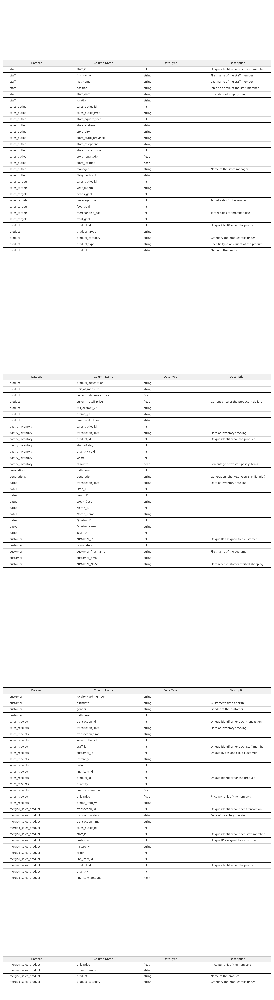

EDA

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import date

plt.rcParams["figure.figsize"] = (8, 4)
pd.options.display.float_format = "{:,.2f}".format

base_path = "/content/drive/MyDrive/Info442_CafeProject/Data/Coffee Shop Sample Data"


In [ ]:
#Load Datasets
customer        = pd.read_csv(f"{base_path}/customer_clean.csv", parse_dates=['customer_since', 'birthdate'])
dates           = pd.read_csv(f"{base_path}/dates_clean.csv", parse_dates=['transaction_date'])
generations     = pd.read_csv(f"{base_path}/generations_clean.csv")
merged          = pd.read_csv(f"{base_path}/merged_sales_product.csv", parse_dates=['transaction_date'])
pastry_inventory= pd.read_csv(f"{base_path}/pastry_inventory_clean.csv", parse_dates=['transaction_date'])
product         = pd.read_csv(f"{base_path}/product_clean.csv")
sales_outlet    = pd.read_csv(f"{base_path}/sales_outlet_clean.csv")
sales_receipts  = pd.read_csv(f"{base_path}/sales_receipts_clean.csv", parse_dates=['transaction_date'])
sales_targets   = pd.read_csv(f"{base_path}/sales_targets_clean.csv")
staff           = pd.read_csv(f"{base_path}/staff_clean.csv", parse_dates=['start_date'])


In [ ]:
#Basic Overview
print("Rows, Cols:", merged.shape)
print("Date Range:", merged["transaction_date"].min(), "→", merged["transaction_date"].max())
print("\nMissing Values:\n", merged.isna().sum().sort_values(ascending=False).head(10))

print("\nNumeric Summary:\n", merged.select_dtypes(include=[np.number]).describe().T)


In [ ]:
# Monthly & Daily Revenue
merged["month"] = merged["transaction_date"].dt.to_period("M").astype(str)
merged["day"]   = merged["transaction_date"].dt.date

# Daily Revenue
daily_revenue = merged.groupby("day")["line_item_amount"].sum().reset_index()

plt.figure()
plt.plot(daily_revenue["day"], daily_revenue["line_item_amount"])
plt.xticks(rotation=45, ha="right")
plt.title("Daily Revenue")
plt.xlabel("Day")
plt.ylabel("Revenue")
plt.tight_layout()
plt.show()

# Monthly Revenue
monthly_revenue = merged.groupby("month")["line_item_amount"].sum().reset_index()
print(monthly_revenue)


In [ ]:
# Top 10 Products
top_products = (merged.groupby("product")["line_item_amount"]
                .sum()
                .reset_index()
                .sort_values("line_item_amount", ascending=False)
                .head(10))
print(top_products)

plt.figure()
plt.bar(top_products["product"], top_products["line_item_amount"])
plt.xticks(rotation=45, ha="right")
plt.title("Top 10 Products by Revenue")
plt.xlabel("Product")
plt.ylabel("Revenue")
plt.tight_layout()
plt.show()

# Product Categories
if "product_category" in merged.columns:
    category_revenue = (merged.groupby("product_category")["line_item_amount"]
                        .sum()
                        .reset_index()
                        .sort_values("line_item_amount", ascending=False))
    print(category_revenue)


In [ ]:
#Customer Demographics
merged_demo = merged.merge(customer[["customer_id", "birthdate", "gender"]],
                           on="customer_id", how="left")
today = pd.Timestamp(date.today())
merged_demo["age"] = (today - merged_demo["birthdate"]).dt.days // 365

print(merged_demo.groupby("gender")["line_item_amount"].sum())

plt.figure()
merged_demo["age"].dropna().plot(kind="hist", bins=20)
plt.title("Customer Age Distribution")
plt.xlabel("Age")
plt.ylabel("Count")
plt.tight_layout()
plt.show()


### Dataset 3: coffee tasting survey (Sabrina)
https://www.kaggle.com/datasets/sujaykapadnis/lets-do-some-coffee-tasting

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving GACTT_RESULTS_ANONYMIZED_v2.csv to GACTT_RESULTS_ANONYMIZED_v2 (1).csv


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv('GACTT_RESULTS_ANONYMIZED_v2.csv')
df.head()

,Submission ID,What is your age?,How many cups of coffee do you typically drink per day?,Where do you typically drink coffee?,Where do you typically drink coffee? (At home),Where do you typically drink coffee? (At the office),Where do you typically drink coffee? (On the go),Where do you typically drink coffee? (At a cafe),Where do you typically drink coffee? (None of these),How do you brew coffee at home?,...,Approximately how much have you spent on coffee equipment in the past 5 years?,Do you feel like you’re getting good value for your money with regards to your coffee equipment?,Gender,Gender (please specify),Education Level,Ethnicity/Race,Ethnicity/Race (please specify),Employment Status,Number of Children,Political Affiliation
0,gMR29l,18-24 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,BkPN0e,25-34 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pod/capsule machine (e.g. Keurig/Nespresso),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,W5G8jj,25-34 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Bean-to-cup machine,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4xWgGr,35-44 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Coffee brewing machine (e.g. Mr. Coffee),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,QD27Q8,25-34 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pour over,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
print(df.shape)

(4042, 113)


In [ ]:
sns.set(style="whitegrid")
plt.rcParams["figure.figsize"] = (12, 6)

In [ ]:
#Clean column names

df.columns = df.columns.str.strip().str.lower().str.replace(" ", "_") \
    .str.replace("?", "").str.replace("(", "").str.replace(")", "") \
    .str.replace("-", "_").str.replace("/", "_").str.replace(",", "")

In [ ]:
tasting_cols = [col for col in df.columns if 'coffee_' in col and any(x in col for x in ['bitterness', 'acidity', 'personal_preference'])]
df[tasting_cols] = df[tasting_cols].apply(pd.to_numeric, errors='coerce')

# 5.1 Drop rows missing all coffee tasting data
df = df[~df[tasting_cols].isnull().all(axis=1)].copy()

# 5.2 Impute missing values in tasting scores with column medians
df[tasting_cols] = df[tasting_cols].apply(lambda col: col.fillna(col.median()))

# 5.3 Drop free-text columns with over 80% missing values
text_cols = [col for col in df.columns if df[col].dtype == 'object' and df[col].nunique() < 30]
high_missing_text_cols = [col for col in text_cols if df[col].isnull().mean() > 0.8]
df.drop(columns=high_missing_text_cols, inplace=True)

# 5.4 Drop duplicates
df.drop_duplicates(inplace=True)

In [ ]:
print(df.shape)
print(df.columns[:10])  # Show first 10 column names
print(df.info())
print(df.isnull().sum().sort_values(ascending=False).head(10))

(3807, 97)
Index(['submission_id', 'what_is_your_age',
       'how_many_cups_of_coffee_do_you_typically_drink_per_day',
       'where_do_you_typically_drink_coffee',
       'where_do_you_typically_drink_coffee_at_home',
       'where_do_you_typically_drink_coffee_at_the_office',
       'where_do_you_typically_drink_coffee_on_the_go',
       'where_do_you_typically_drink_coffee_at_a_cafe',
       'where_do_you_typically_drink_coffee_none_of_these',
       'how_do_you_brew_coffee_at_home'],
      dtype='object')
<class 'pandas.core.frame.DataFrame'>
Index: 3807 entries, 8 to 4041
Data columns (total 97 columns):
 #   Column                                                                                           Non-Null Count  Dtype  
---  ------                                                                                           --------------  -----  
 0   submission_id                                                                                    3807 non-null   object 
 1  

In [ ]:
# Clean age column
df['age'] = df['what_is_your_age'].str.extract(r'(\d+)').astype(float)
df['age_group'] = pd.cut(df['age'], bins=[0, 24, 34, 44, 54, 64, 120],
                         labels=['18–24', '25–34', '35–44', '45–54', '55–64', '65+'])

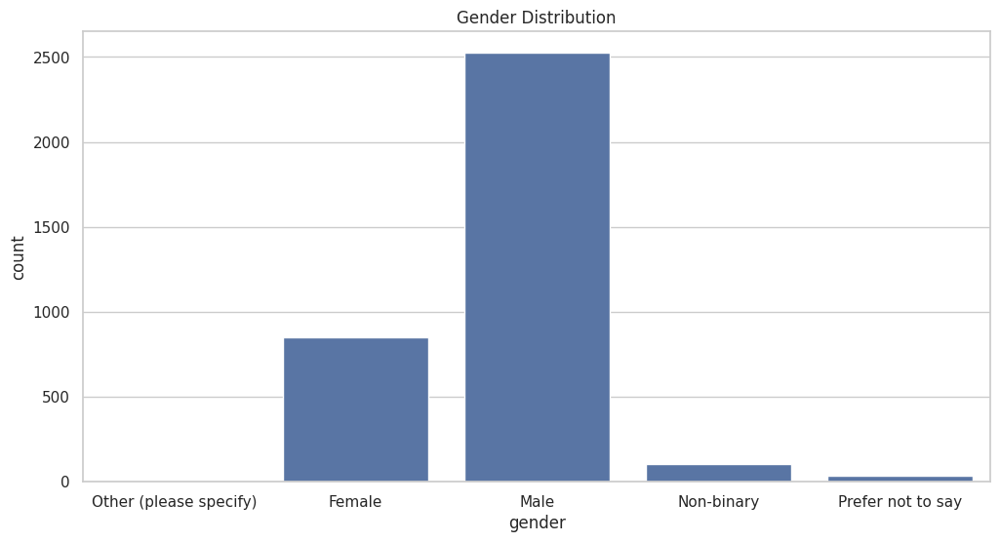

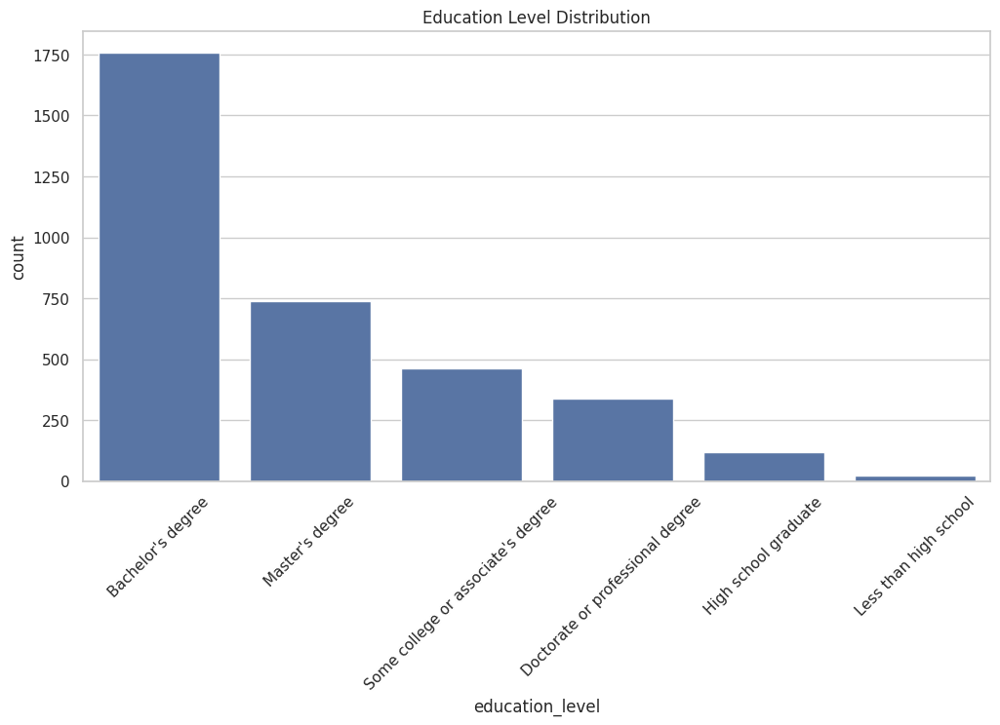

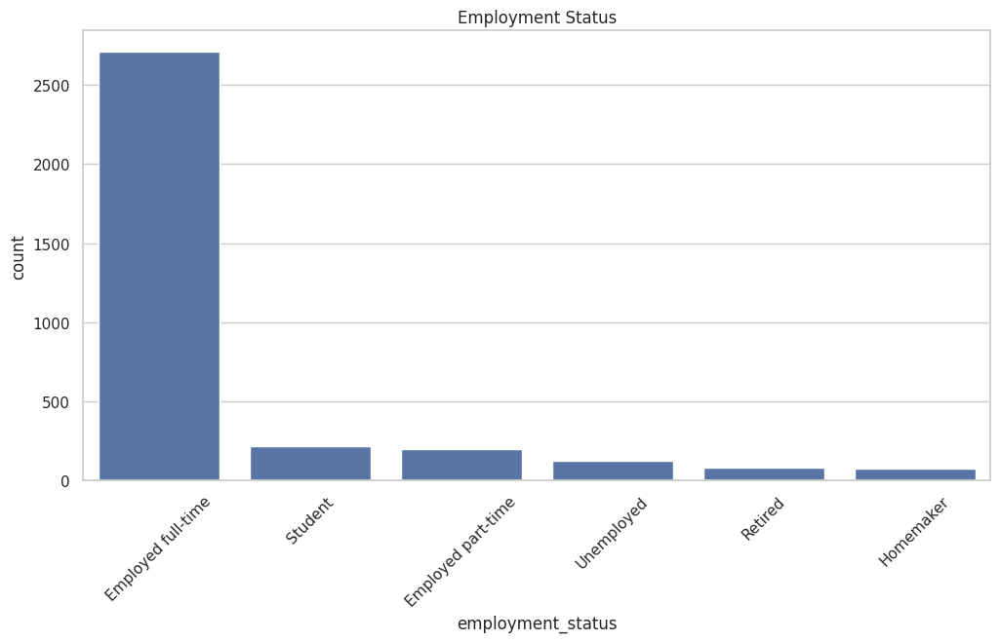

In [ ]:
#Demographic distribution

if 'gender' in df.columns:
    sns.countplot(x='gender', data=df)
    plt.title("Gender Distribution")
    plt.show()

if 'education_level' in df.columns:
    sns.countplot(x='education_level', data=df, order=df['education_level'].value_counts().index)
    plt.title("Education Level Distribution")
    plt.xticks(rotation=45)
    plt.show()

if 'employment_status' in df.columns:
    sns.countplot(x='employment_status', data=df, order=df['employment_status'].value_counts().index)
    plt.title("Employment Status")
    plt.xticks(rotation=45)
    plt.show()

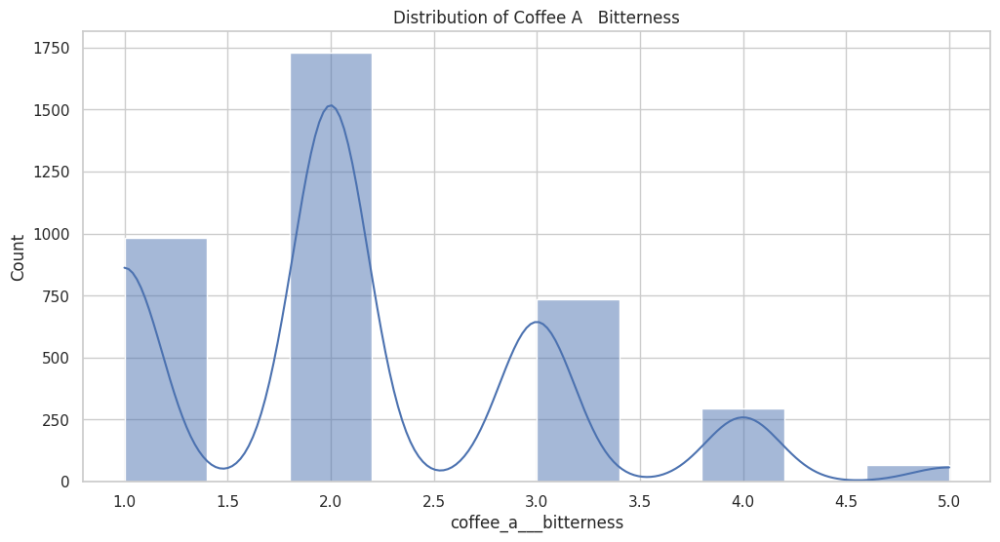

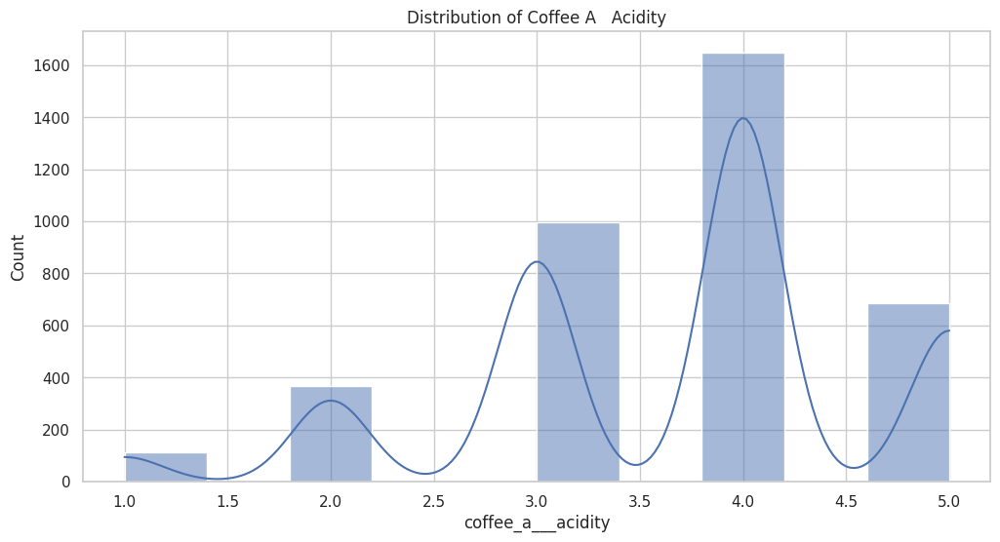

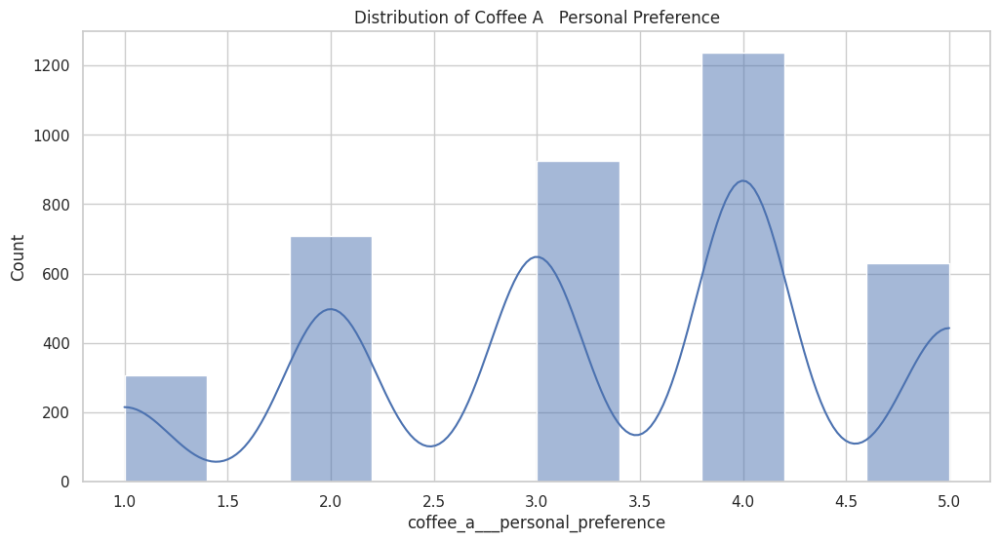

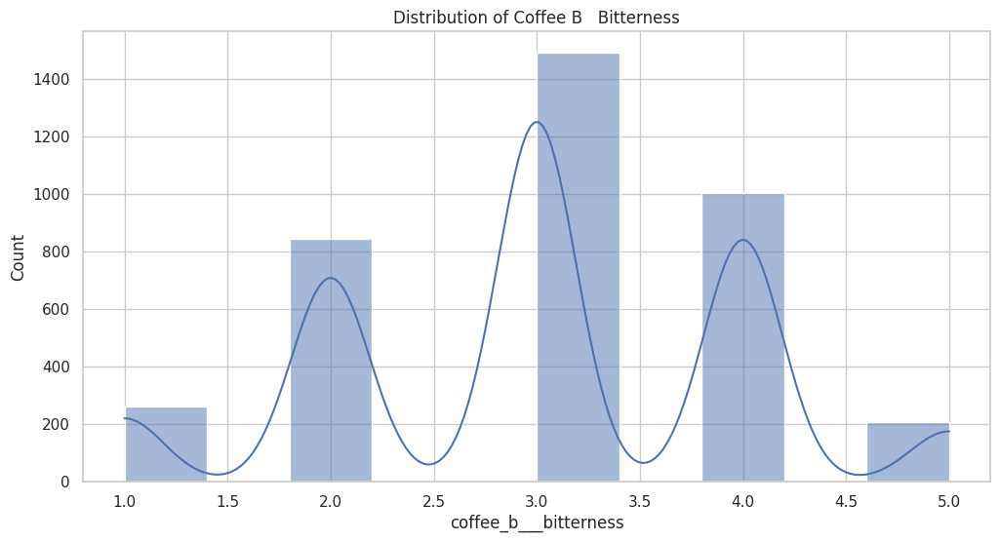

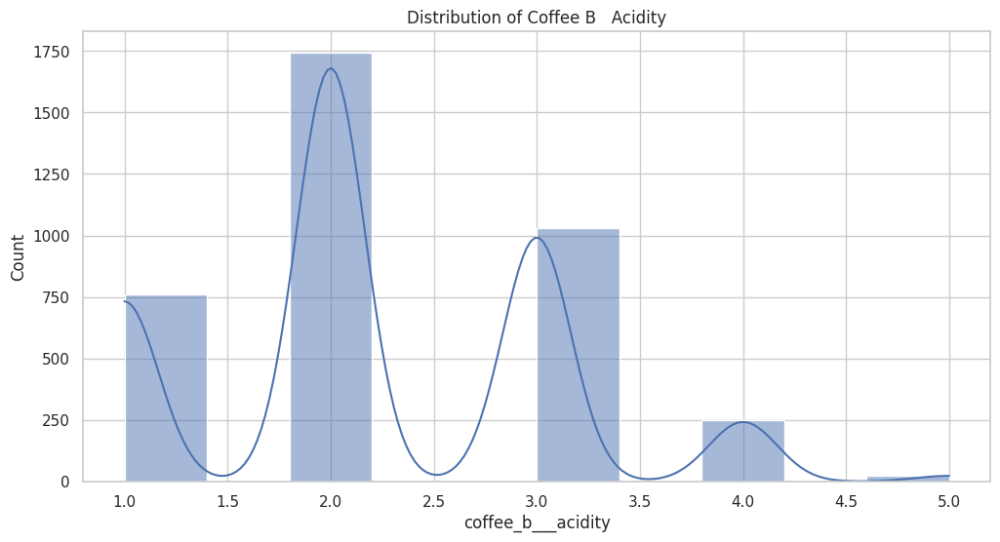

...

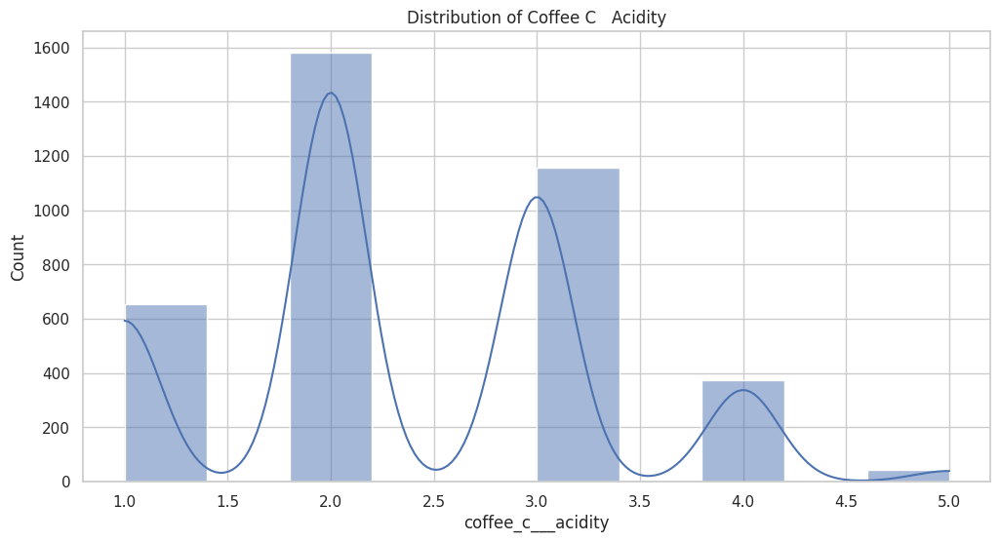

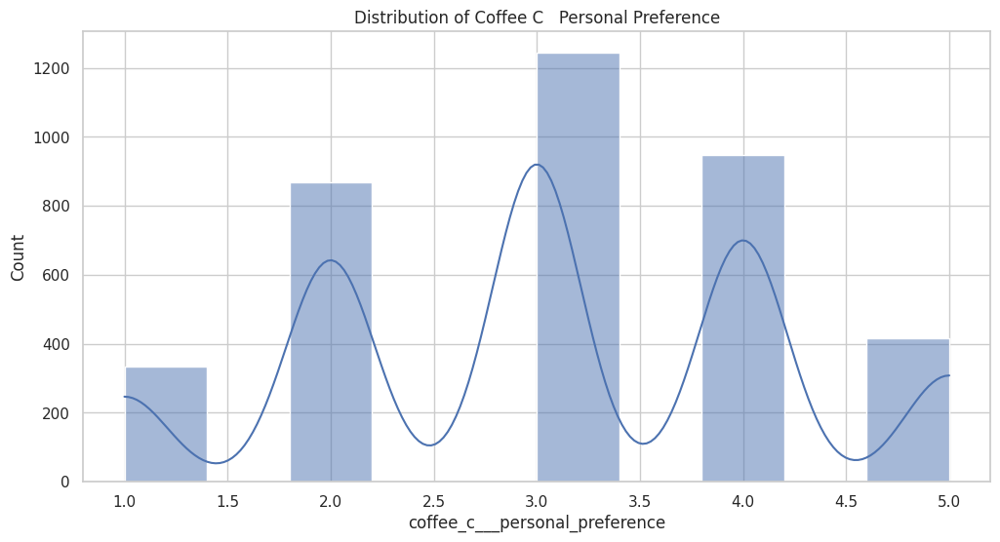

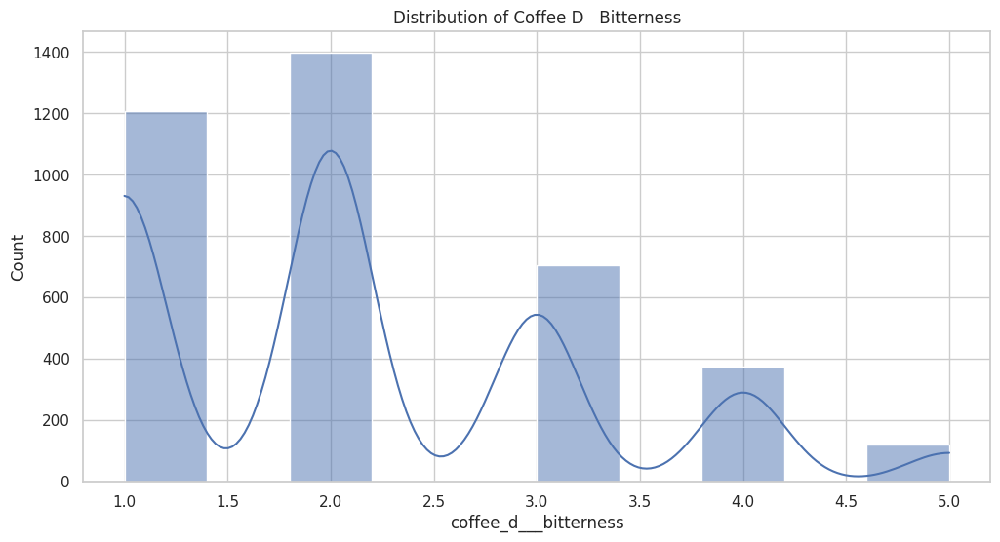

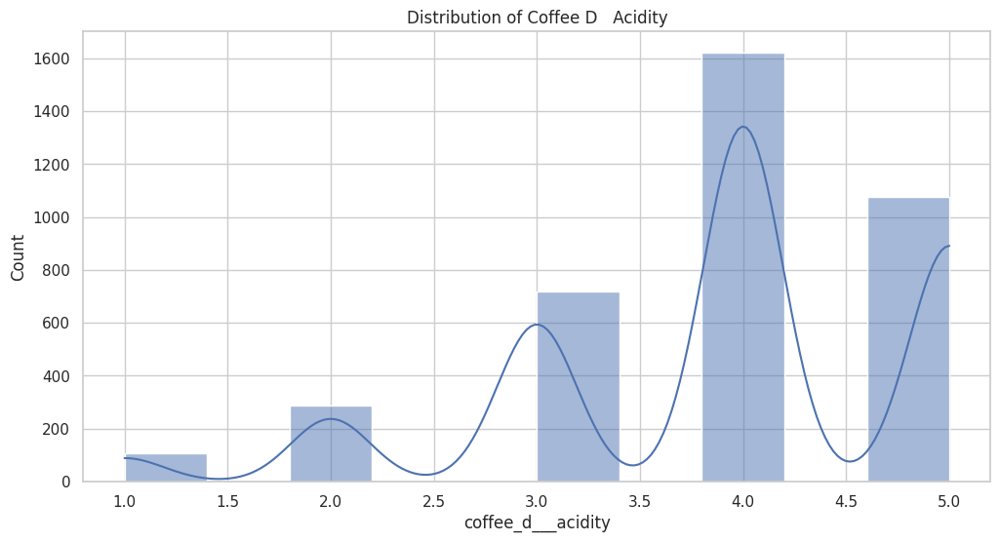

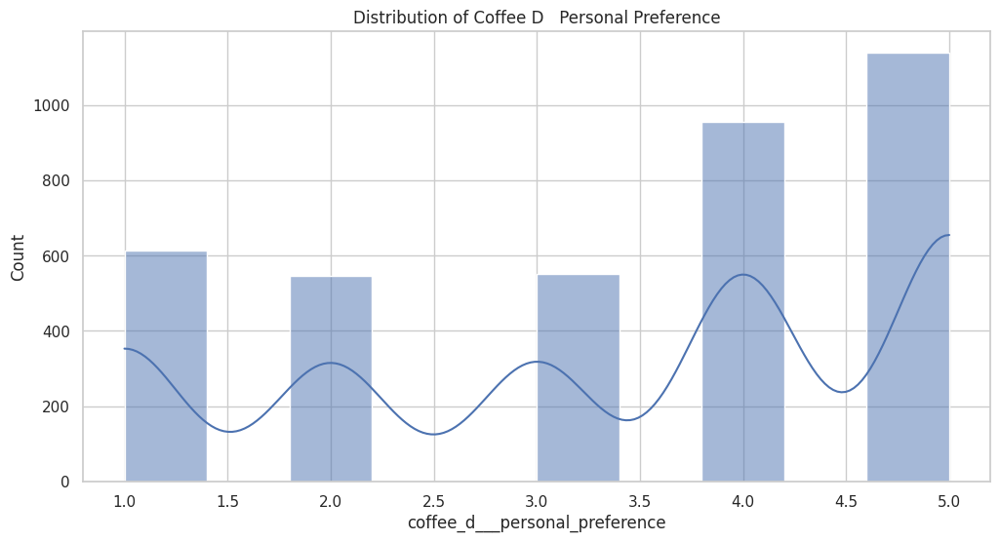

In [ ]:
for col in tasting_cols:
    sns.histplot(df[col], bins=10, kde=True)
    plt.title(f'Distribution of {col.replace("_", " ").title()}')
    plt.show()

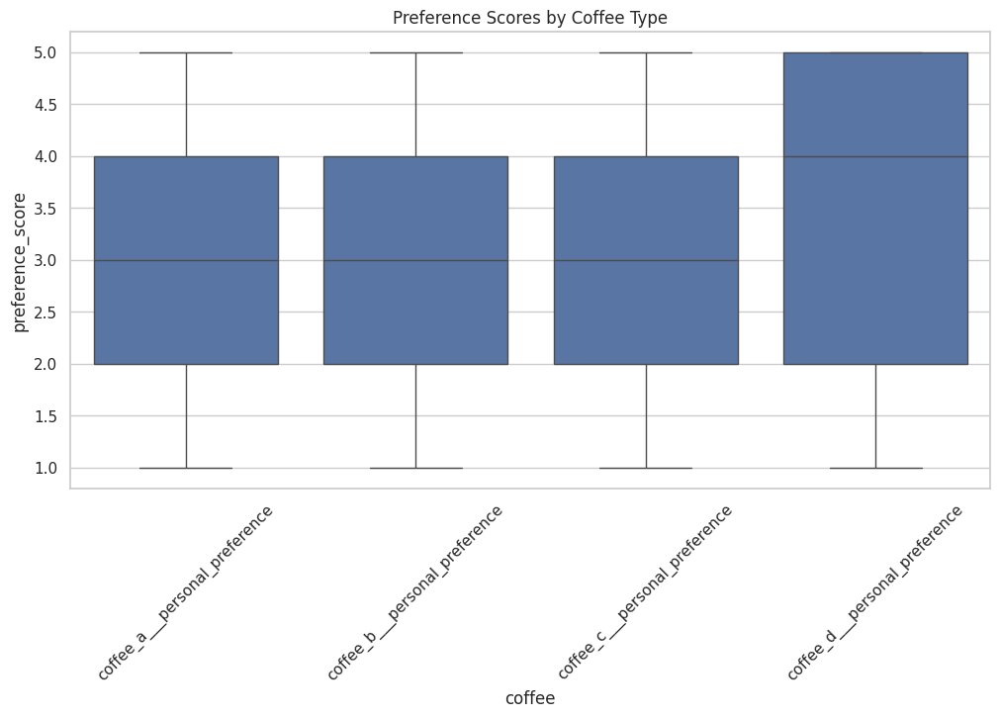

In [ ]:
# Boxplot of preference scores per coffee
coffee_prefs = [col for col in tasting_cols if 'personal_preference' in col]
melted_prefs = df[coffee_prefs].melt(var_name="coffee", value_name="preference_score")
sns.boxplot(x="coffee", y="preference_score", data=melted_prefs)
plt.title("Preference Scores by Coffee Type")
plt.xticks(rotation=45)
plt.show()

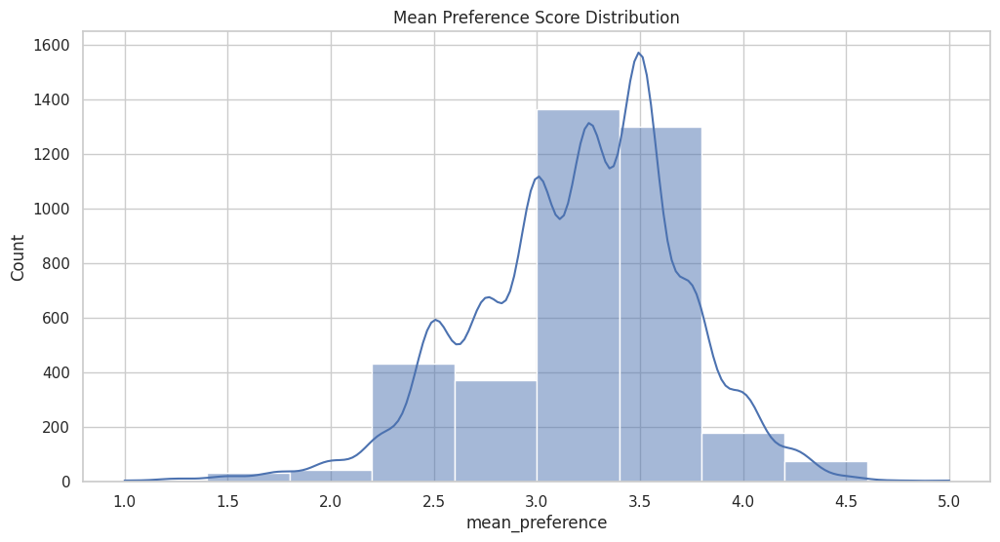

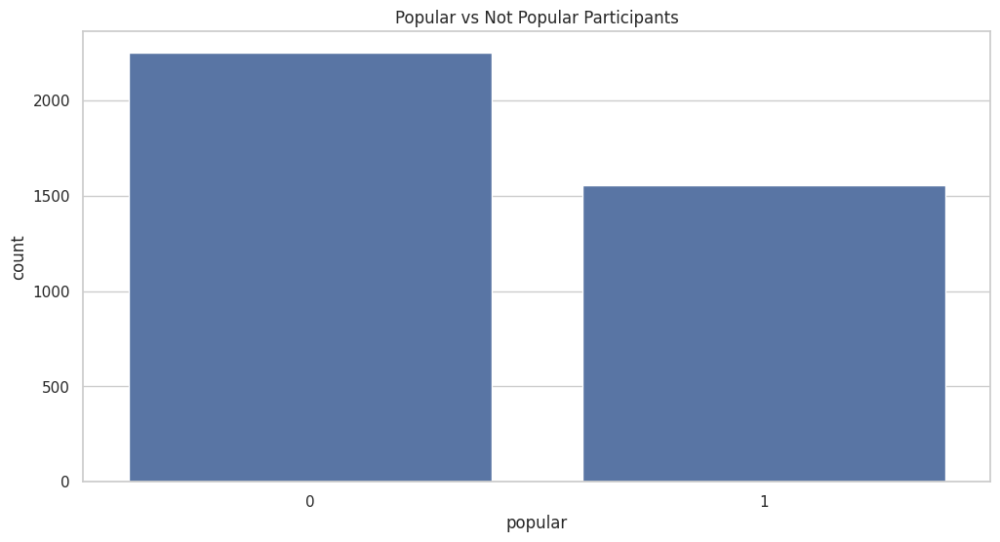

In [ ]:
# Mean preference of all coffees
df['mean_preference'] = df[coffee_prefs].mean(axis=1)

# Create binary label: popular if in top 25%
threshold = df['mean_preference'].quantile(0.75)
df['popular'] = (df['mean_preference'] >= threshold).astype(int)

sns.histplot(df['mean_preference'], bins=10, kde=True)
plt.title("Mean Preference Score Distribution")
plt.show()

sns.countplot(x='popular', data=df)
plt.title("Popular vs Not Popular Participants")
plt.show()

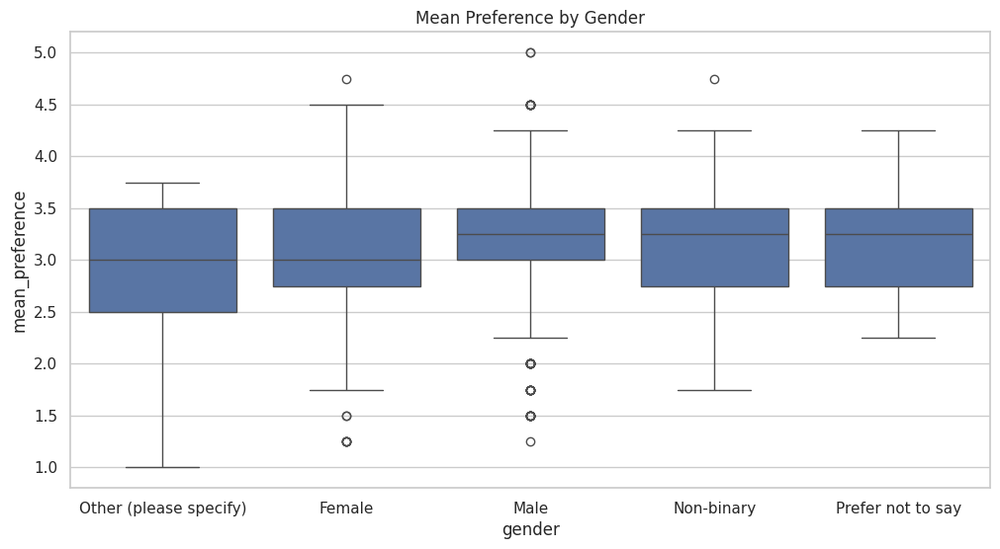

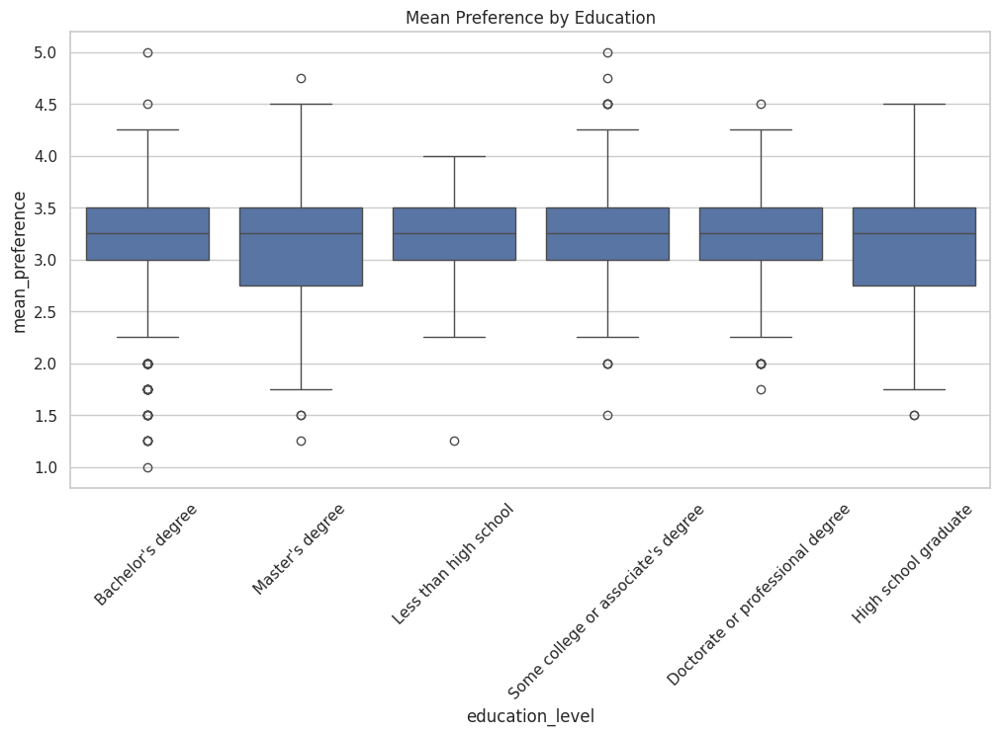

In [ ]:
if 'gender' in df.columns:
    sns.boxplot(x='gender', y='mean_preference', data=df)
    plt.title("Mean Preference by Gender")
    plt.show()

if 'education_level' in df.columns:
    sns.boxplot(x='education_level', y='mean_preference', data=df)
    plt.title("Mean Preference by Education")
    plt.xticks(rotation=45)
    plt.show()

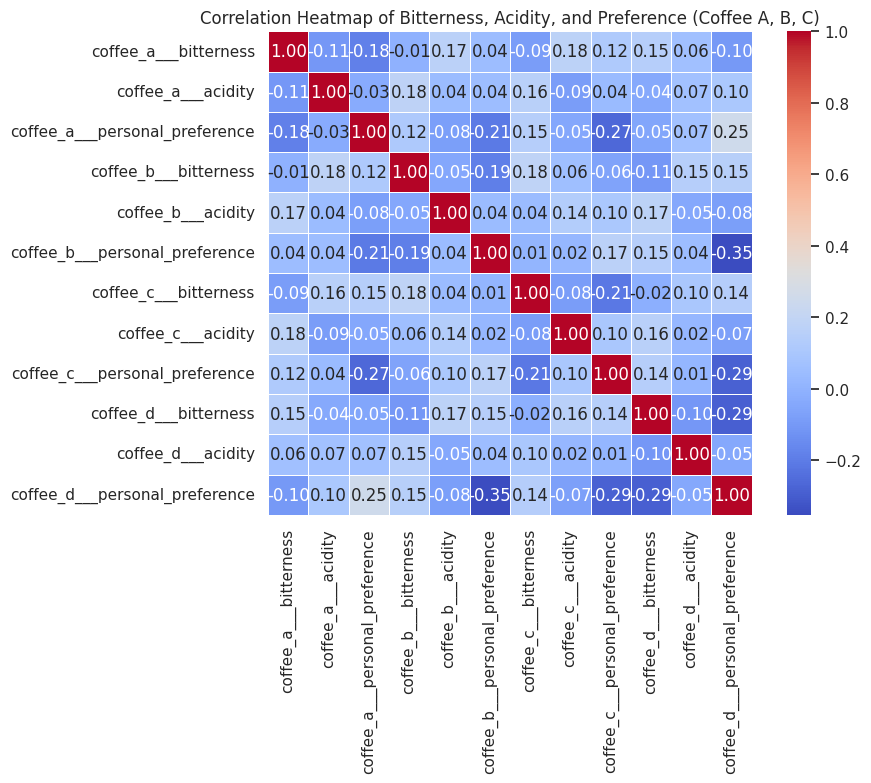

In [ ]:
taste_cols = [col for col in df.columns if any(x in col for x in ['bitterness', 'acidity', 'personal_preference'])]

# Compute correlation matrix
corr_matrix = df[taste_cols].corr()

# This heatmap helps identify how variables like bitterness, acidity, and preference relate across different coffees
plt.figure(figsize=(10, 8))
corr_matrix = df[taste_cols].corr()  # Compute correlation matrix
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True, linewidths=0.5)
plt.title("Correlation Heatmap of Bitterness, Acidity, and Preference (Coffee A, B, C)")
plt.tight_layout()
plt.show()

Data Dictionary

## ☕ Coffee Tasting Survey – Data Dictionary

| Variable Name                    | Description                                                                | Data Type     | Possible Values / Range                                                        |
|----------------------------------|----------------------------------------------------------------------------|---------------|---------------------------------------------------------------------------------|
| `gender`                         | Respondent's self-identified gender                                        | Categorical   | Male, Female, Non-binary, Prefer not to say, Other                             |
| `education_level`                | Highest level of education completed by respondent                        | Categorical   | Less than high school, High School graduate, Bachelor's, Master's, Doctorate   |
| `employment_status`             | Current employment status                                                 | Categorical   | Employed full-time, Employed part-time, Student, Unemployed, Retired, Homemaker |
| `coffee_a__bitterness`           | Perceived bitterness of Coffee A                                          | Ordinal (1–5) | 1 = Not bitter, 5 = Extremely bitter                                            |
| `coffee_a__acidity`              | Perceived acidity of Coffee A                                             | Ordinal (1–5) | 1 = Not acidic, 5 = Extremely acidic                                            |
| `coffee_a__personal_preference`  | Overall personal preference for Coffee A                                  | Ordinal (1–5) | 1 = Dislike, 5 = Like very much                                                 |
| `coffee_b__bitterness`           | Perceived bitterness of Coffee B                                          | Ordinal (1–5) | 1 = Not bitter, 5 = Extremely bitter                                            |
| `coffee_b__acidity`              | Perceived acidity of Coffee B                                             | Ordinal (1–5) | 1 = Not acidic, 5 = Extremely acidic                                            |
| `coffee_b__personal_preference`  | Overall personal preference for Coffee B                                  | Ordinal (1–5) | 1 = Dislike, 5 = Like very much                                                 |
| `coffee_c__bitterness`           | Perceived bitterness of Coffee C                                          | Ordinal (1–5) | 1 = Not bitter, 5 = Extremely bitter                                            |
| `coffee_c__acidity`              | Perceived acidity of Coffee C                                             | Ordinal (1–5) | 1 = Not acidic, 5 = Extremely acidic                                            |
| `coffee_c__personal_preference`  | Overall personal preference for Coffee C                                  | Ordinal (1–5) | 1 = Dislike, 5 = Like very much                                                 |





### Dataset 4: yelp reviews - Sparsh
https://www.kaggle.com/datasets/sripaadsrinivasan/yelp-coffee-reviews

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving ratings_and_sentiments.csv to ratings_and_sentiments (2).csv
Saving raw_yelp_review_data.csv to raw_yelp_review_data (2).csv
Saving sentiments_by_shop.csv to sentiments_by_shop (2).csv


In [ ]:
import pandas as pd

ratings_and_sentiments = pd.read_csv("ratings_and_sentiments.csv", encoding="ISO-8859-1")
raw_yelp_review_data = pd.read_csv("raw_yelp_review_data.csv")
sentiments_by_shop = pd.read_csv("sentiments_by_shop.csv")
def normalize_columns(df):
    df.columns = df.columns.str.strip().str.lower().str.replace(" ", "_").str.replace("[^a-z0-9_]", "")
    return df

ratings_and_sentiments = normalize_columns(ratings_and_sentiments)
raw_yelp_review_data = normalize_columns(raw_yelp_review_data)
sentiments_by_shop = normalize_columns(sentiments_by_shop)

print(set(ratings_and_sentiments.columns) & set(raw_yelp_review_data.columns))
print(set(ratings_and_sentiments.columns) & set(sentiments_by_shop.columns))


for df in [ratings_and_sentiments, raw_yelp_review_data, sentiments_by_shop]:
    df['coffee_shop_name'] = df['coffee_shop_name'].str.strip().str.lower()


ratings_names = set(ratings_and_sentiments['coffee_shop_name'].unique())
review_names = set(raw_yelp_review_data['coffee_shop_name'].unique())
sentiment_names = set(sentiments_by_shop['coffee_shop_name'].unique())

unmatched_reviews = review_names - ratings_names
unmatched_sentiments = sentiment_names - ratings_names
print("Unmatched in Reviews:", unmatched_reviews)
print("Unmatched in Sentiments:", unmatched_sentiments)

merged_df = ratings_and_sentiments.merge(
    sentiments_by_shop, on="coffee_shop_name", how="left"
).merge(
    raw_yelp_review_data, on="coffee_shop_name", how="left"
)

print(merged_df.head())

merged_df.to_csv("merged_yelp_coffee_data.csv", index=False)


{'coffee_shop_name'}
{'coffee_shop_name', 'rating'}
Unmatched in Reviews: {'brian’s brew', 'cuvée coffee bar', 'jo’s coffee', 'caffé medici', 'quack’s 43rd street bakery', 'mozart’s coffee roasters', 'alta’s cafe', 'anderson’s coffee company', 'russell’s bakery', 'sorrento’s coffee', 'stinson’s', 'café java', 'mañana coffee & juice', 'hot mama’s cafe', 'arturo’s underground cafe', 'café crème', 'mary’s cafe'}
Unmatched in Sentiments: {'cafe creme', 'lola savannah coffee', 'manana coffee & juice'}
                 coffee_shop_name  \
0  the factory - cafe with a soul   
1  the factory - cafe with a soul   
2  the factory - cafe with a soul   
3  the factory - cafe with a soul   
4  the factory - cafe with a soul   

                                         review_text           rating_x  \
0   11/25/2016 1 check-in Love love loved the vib...   5.0 star rating    
1   11/25/2016 1 check-in Love love loved the vib...   5.0 star rating    
2   11/25/2016 1 check-in Love love loved the vib.

In [ ]:
#preprocessing steps:
#1. normalizing columns
def normalize_columns(df):
    df.columns = df.columns.str.strip().str.lower().str.replace(" ", "_").str.replace("[^a-z0-9_]", "", regex=True)
    return df
ratings_and_sentiments = normalize_columns(ratings_and_sentiments)
raw_yelp_review_data = normalize_columns(raw_yelp_review_data)
sentiments_by_shop = normalize_columns(sentiments_by_shop)
#converting coffee_shop_names to lowercase
for df in [ratings_and_sentiments, raw_yelp_review_data, sentiments_by_shop]:
    if 'coffee_shop_name' in df.columns:
        df['coffee_shop_name'] = df['coffee_shop_name'].astype(str).str.strip().str.lower()
ratings_info = ratings_and_sentiments.info()
ratings_describe = ratings_and_sentiments.describe(include='all')
ratings_nulls = ratings_and_sentiments.isnull().sum()
ratings_head = ratings_and_sentiments.head()
raw_yelp_head = raw_yelp_review_data.head()
sentiments_head = sentiments_by_shop.head()

ratings_head, raw_yelp_head, sentiments_head, ratings_describe, ratings_nulls

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7621 entries, 0 to 7620
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   coffee_shop_name  7621 non-null   object 
 1   review_text       7616 non-null   object 
 2   rating            7616 non-null   object 
 3   num_rating        7616 non-null   float64
 4   cat_rating        7616 non-null   object 
 5   bool_high         7616 non-null   float64
 6   overall_sent      7616 non-null   float64
 7   vibe_sent         4507 non-null   object 
 8   tea_sent          7616 non-null   float64
 9   service_sent      7616 non-null   float64
 10  seating_sent      7616 non-null   float64
 11  price_sent        7616 non-null   float64
 12  parking_sent      7616 non-null   object 
 13  location_sent     7616 non-null   float64
 14  alcohol_sent      7616 non-null   float64
 15  coffee_sent       7616 non-null   object 
 16  food_sent         7616 non-null   object 


(                 coffee_shop_name  \
 0  the factory - cafe with a soul   
 1  the factory - cafe with a soul   
 2  the factory - cafe with a soul   
 3  the factory - cafe with a soul   
 4  the factory - cafe with a soul   
 
                                          review_text             rating  \
 0   11/25/2016 1 check-in Love love loved the vib...   5.0 star rating    
 1   12/2/2016 Listed in Date Night: Austin, vibe ...   4.0 star rating    
 2   11/30/2016 1 check-in Listed in food seating ...   4.0 star rating    
 3   11/25/2016 Very cool vibe! Good drinks Nice s...   2.0 star rating    
 4   12/3/2016 1 check-in They are location within...   4.0 star rating    
 
    num_rating cat_rating  bool_high  overall_sent vibe_sent  tea_sent  \
 0        5.00       HIGH       1.00          4.00         3      0.00   
 1        4.00       HIGH       1.00          3.00         3      0.00   
 2        4.00       HIGH       1.00          2.00         2      0.00   
 3        2.00  

In [ ]:
#2. lowercase all string columns
for col in ratings_and_sentiments.select_dtypes(include='object').columns:
    ratings_and_sentiments[col] = ratings_and_sentiments[col].astype(str).str.lower()
ratings_and_sentiments.head()


,coffee_shop_name,review_text,rating,num_rating,cat_rating,bool_high,overall_sent,vibe_sent,tea_sent,service_sent,seating_sent,price_sent,parking_sent,location_sent,alcohol_sent,coffee_sent,food_sent,hours_sent,internet_sent,local_sent
0,the factory - cafe with a soul,11/25/2016 1 check-in love love loved the vib...,5.0 star rating,5.00,high,1.00,4.00,3,0.00,0.00,0.00,0.00,0,0.00,1.00,3,0,0.00,0.00,0.00
1,the factory - cafe with a soul,"12/2/2016 listed in date night: austin, vibe ...",4.0 star rating,4.00,high,1.00,3.00,3,0.00,0.00,0.00,0.00,0,0.00,0.00,0,2,0.00,0.00,0.00
2,the factory - cafe with a soul,11/30/2016 1 check-in listed in food seating ...,4.0 star rating,4.00,high,1.00,2.00,2,0.00,0.00,3.00,0.00,0,0.00,0.00,-1,2,0.00,0.00,0.00
3,the factory - cafe with a soul,11/25/2016 very cool vibe! good drinks nice s...,2.0 star rating,2.00,low,0.00,1.00,0,0.00,0.00,-1.00,-1.00,0,0.00,0.00,0,0,0.00,0.00,0.00
4,the factory - cafe with a soul,12/3/2016 1 check-in they are location within...,4.0 star rating,4.00,high,1.00,2.00,0,0.00,0.00,0.00,0.00,3,0.00,0.00,0,0,0.00,0.00,0.00


In [ ]:
#3. droping irrelevant or duplicate columns
columns_to_drop = ['rating', 'cat_rating', 'bool_high']
ratings_and_sentiments_cleaned = ratings_and_sentiments.drop(columns=columns_to_drop)
ratings_and_sentiments_cleaned.head()


,coffee_shop_name,review_text,num_rating,overall_sent,vibe_sent,tea_sent,service_sent,seating_sent,price_sent,parking_sent,location_sent,alcohol_sent,coffee_sent,food_sent,hours_sent,internet_sent,local_sent
0,the factory - cafe with a soul,11/25/2016 1 check-in love love loved the vib...,5.00,4.00,3,0.00,0.00,0.00,0.00,0,0.00,1.00,3,0,0.00,0.00,0.00
1,the factory - cafe with a soul,"12/2/2016 listed in date night: austin, vibe ...",4.00,3.00,3,0.00,0.00,0.00,0.00,0,0.00,0.00,0,2,0.00,0.00,0.00
2,the factory - cafe with a soul,11/30/2016 1 check-in listed in food seating ...,4.00,2.00,2,0.00,0.00,3.00,0.00,0,0.00,0.00,-1,2,0.00,0.00,0.00
3,the factory - cafe with a soul,11/25/2016 very cool vibe! good drinks nice s...,2.00,1.00,0,0.00,0.00,-1.00,-1.00,0,0.00,0.00,0,0,0.00,0.00,0.00
4,the factory - cafe with a soul,12/3/2016 1 check-in they are location within...,4.00,2.00,0,0.00,0.00,0.00,0.00,3,0.00,0.00,0,0,0.00,0.00,0.00


In [ ]:
from google.colab import files
uploaded = files.upload()

Saving ratings_and_sentiments.csv to ratings_and_sentiments (3).csv
Saving raw_yelp_review_data.csv to raw_yelp_review_data (3).csv
Saving sentiments_by_shop.csv to sentiments_by_shop (3).csv


In [ ]:
import pandas as pd

# Load the datasets
ratings_and_sentiments = pd.read_csv("ratings_and_sentiments.csv", encoding="ISO-8859-1")
raw_yelp_review_data = pd.read_csv("raw_yelp_review_data.csv")
sentiments_by_shop = pd.read_csv("sentiments_by_shop.csv")

# Normalize column names
def normalize_columns(df):
    df.columns = df.columns.str.strip().str.lower().str.replace(" ", "_").str.replace("[^a-z0-9_]", "", regex=True)
    return df

ratings_and_sentiments = normalize_columns(ratings_and_sentiments)
raw_yelp_review_data = normalize_columns(raw_yelp_review_data)
sentiments_by_shop = normalize_columns(sentiments_by_shop)

# Convert coffee_shop_names to lowercase
for df in [ratings_and_sentiments, raw_yelp_review_data, sentiments_by_shop]:
    if 'coffee_shop_name' in df.columns:
        df['coffee_shop_name'] = df['coffee_shop_name'].astype(str).str.strip().str.lower()

# Lowercase all string columns in ratings_and_sentiments
for col in ratings_and_sentiments.select_dtypes(include='object').columns:
    ratings_and_sentiments[col] = ratings_and_sentiments[col].astype(str).str.lower()

# Drop irrelevant or duplicate columns
columns_to_drop = ['rating', 'cat_rating', 'bool_high']
ratings_and_sentiments_cleaned = ratings_and_sentiments.drop(columns=columns_to_drop)

print("Yelp data loaded and preprocessed successfully!")

Yelp data loaded and preprocessed successfully!


EDA:

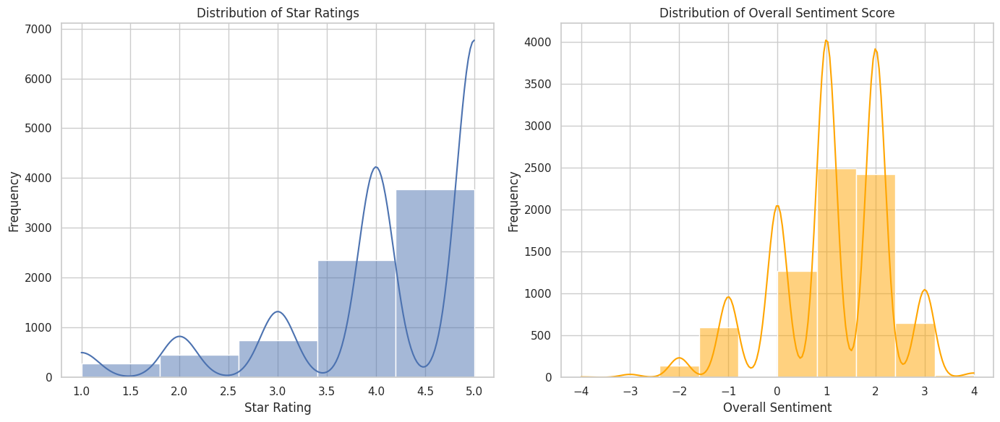

(hours_sent          6
 seating_sent        5
 tea_sent            5
 internet_sent       5
 alcohol_sent        5
 location_sent       5
 price_sent          5
 service_sent        5
 local_sent          5
 overall_sent        5
 bool_high           5
 num_rating          5
 vibe_sent           0
 review_text         0
 parking_sent        0
 cat_rating          0
 coffee_sent         0
 food_sent           0
 rating              0
 coffee_shop_name    0
 dtype: int64,
        num_rating  bool_high  overall_sent  tea_sent  service_sent  \
 count    7,616.00   7,616.00      7,616.00  7,616.00      7,616.00   
 mean         4.17       0.81          1.11      0.05          0.33   
 std          1.07       0.40          1.18      0.33          0.83   
 min          1.00       0.00         -4.00     -3.00         -4.00   
 25%          4.00       1.00          0.00      0.00          0.00   
 50%          4.00       1.00          1.00      0.00          0.00   
 75%          5.00       1.0

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Setting the plot style
sns.set(style="whitegrid")

# Checking for missing values across all datasets
missing_ratings_sentiments = ratings_and_sentiments.isnull().sum().sort_values(ascending=False)
missing_raw_reviews = raw_yelp_review_data.isnull().sum().sort_values(ascending=False)
missing_sentiments_by_shop = sentiments_by_shop.isnull().sum().sort_values(ascending=False)

# Summary statistics for key numerical columns in ratings_and_sentiments
ratings_sentiments_stats = ratings_and_sentiments.describe()

# Distribution plots for rating and overall_sentiment
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
sns.histplot(ratings_and_sentiments['num_rating'], bins=5, kde=True)
plt.title('Distribution of Star Ratings')
plt.xlabel('Star Rating')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
sns.histplot(ratings_and_sentiments['overall_sent'], bins=10, kde=True, color='orange')
plt.title('Distribution of Overall Sentiment Score')
plt.xlabel('Overall Sentiment')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

missing_ratings_sentiments, ratings_sentiments_stats, missing_raw_reviews, missing_sentiments_by_shop

Summary:
Mean- 4.16, with a left- skewed distribution. This implies that most ratings are 4 or 5.
The overall sentiment has a mean of 1.11, which implies that generally most sentiments are positive.
Most star ratings are clearly right skewed, with 4 or 5 dominating the reviews.  The overall sentiment is bell- shaped but slightly right- skewed, aligned with positive star ratings.


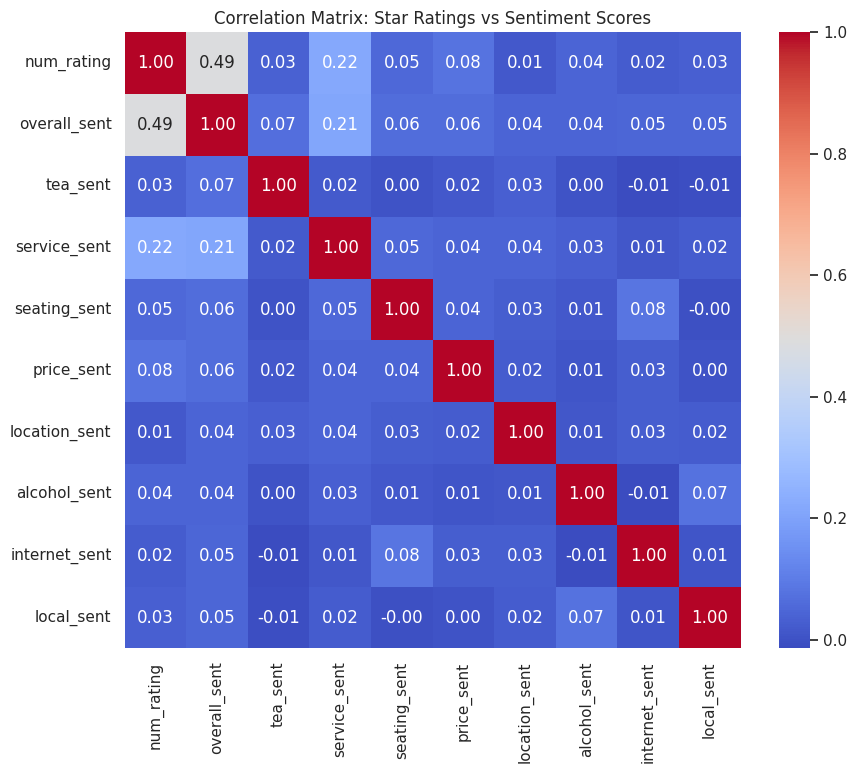

,num_rating
overall_sent,0.49
service_sent,0.22
price_sent,0.08
seating_sent,0.05
alcohol_sent,0.04
tea_sent,0.03
local_sent,0.03
internet_sent,0.02
location_sent,0.01


In [ ]:
#correlation analysis:
sentiment_cols = [
    'overall_sent', 'tea_sent', 'service_sent', 'seating_sent', 'price_sent',
    'location_sent', 'alcohol_sent', 'internet_sent', 'local_sent'
]

# Build correlation DataFrame
correlation_df = ratings_and_sentiments[['num_rating'] + sentiment_cols]
correlation_matrix = correlation_df.corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title("Correlation Matrix: Star Ratings vs Sentiment Scores")
plt.show()

# Sorted correlation values with num_rating
rating_corr_sorted = correlation_matrix['num_rating'].drop('num_rating').sort_values(ascending=False)
rating_corr_sorted

The overall sentiment has the highest and the most meaningful correlation with star rating (0.49). service_sent stands out as the second mot influential factor on star rating, though with a more moderate correlation.
We can conclude that customers look at their whole experience more than the individual aspects to rate a cafe, which must definitely include the beverages prepared.

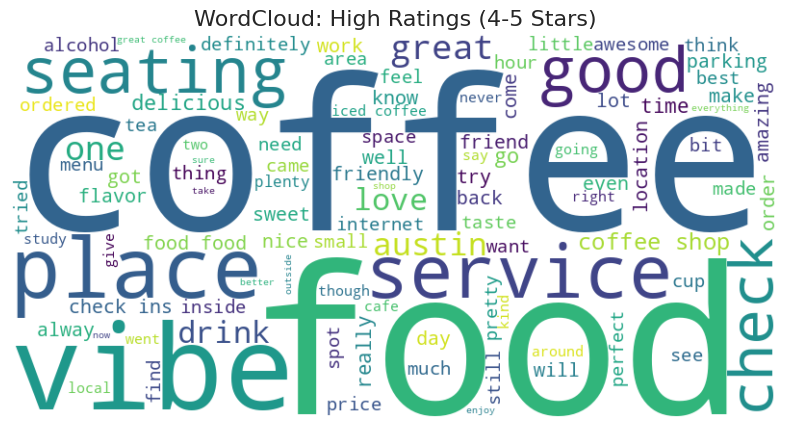

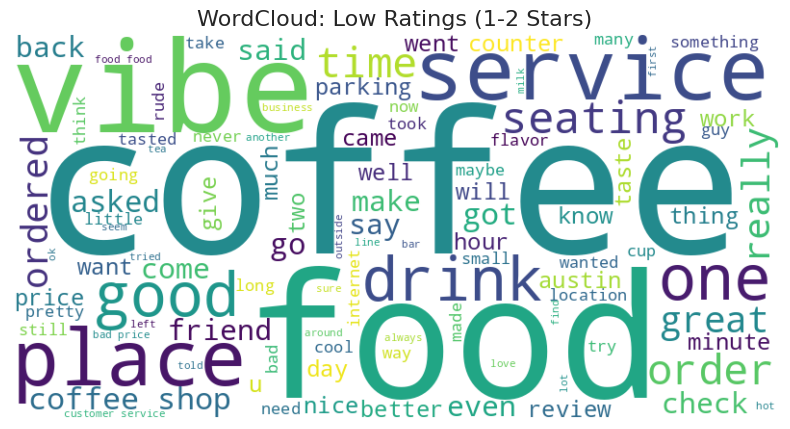

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from wordcloud import WordCloud
import numpy as np

# Creating bins: high (4-5 stars), low (1-2 stars)
ratings_and_sentiments['rating_group'] = pd.cut(
    ratings_and_sentiments['num_rating'],
    bins=[0, 2.5, 5],
    labels=['low', 'high']
)

# Dropping the missing or NaN reviews
clean_reviews_df = ratings_and_sentiments[['review_text', 'rating_group']].dropna()

# Separating the texts by rating group
high_reviews = clean_reviews_df[clean_reviews_df['rating_group'] == 'high']['review_text']
low_reviews = clean_reviews_df[clean_reviews_df['rating_group'] == 'low']['review_text']

# Defining the function to generate wordcloud
def generate_wordcloud(text_series, title):
    text = ' '.join(text_series.astype(str).values)
    wordcloud = WordCloud(width=800, height=400, background_color='white', max_words=100).generate(text)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(title, fontsize=16)
    plt.show()

# Generate wordclouds for high and low rating groups
generate_wordcloud(high_reviews, 'WordCloud: High Ratings (4-5 Stars)')
generate_wordcloud(low_reviews, 'WordCloud: Low Ratings (1-2 Stars)')

Based on the review analysis, we can see how greatly coffee options influence customers' reviews. Hence, our project has valid relevance to improve cafes' revenues by improving their coffee options.

# Modelling- 8/15

In [ ]:
from google.colab import files
files.upload()

In [ ]:
import pandas as pd
cleaned_coffee_shop_sales = pd.read_csv("cleaned_coffee_shop_sales.csv")
merged_sales_product = pd.read_csv("merged_sales_product.csv")

In [ ]:
cleaned_coffee_shop_sales.head()

,transaction_qty,store_location,unit_price,product_category,product_type,product_detail,day,month,year,hour_of_purchase,season,total_revenue
0,2,lower manhattan,3.00,coffee,gourmet brewed coffee,ethiopia rg,sunday,january,2023,7,winter,6.00
1,2,lower manhattan,3.10,tea,brewed chai tea,spicy eye opener chai lg,sunday,january,2023,7,winter,6.20
2,2,lower manhattan,4.50,drinking chocolate,hot chocolate,dark chocolate lg,sunday,january,2023,7,winter,9.00
3,1,lower manhattan,2.00,coffee,drip coffee,our old time diner blend sm,sunday,january,2023,7,winter,2.00
4,2,lower manhattan,3.10,tea,brewed chai tea,spicy eye opener chai lg,sunday,january,2023,7,winter,6.20


In [ ]:
merged_sales_product.head()

,transaction_id,transaction_date,transaction_time,sales_outlet_id,staff_id,customer_id,instore_yn,order,line_item_id,product_id,quantity,line_item_amount,unit_price,promo_item_yn,product,product_category
0,7,2019-04-01,12:04:43,3,12,558,N,1,1,52,1,2.50,2.50,N,Traditional Blend Chai Rg,Tea
1,11,2019-04-01,15:54:39,3,17,781,N,1,1,27,2,7.00,3.50,N,Brazilian Lg,Coffee
2,19,2019-04-01,14:34:59,3,17,788,Y,1,1,46,2,5.00,2.50,N,Serenity Green Tea Rg,Tea
3,32,2019-04-01,16:06:04,3,12,683,N,1,1,23,2,5.00,2.50,N,Our Old Time Diner Blend Rg,Coffee
4,33,2019-04-01,19:18:37,3,17,99,Y,1,1,34,1,2.45,2.45,N,Jamaican Coffee River Sm,Coffee


The previous merge within individual datasets couldn't further be combined into one due to inconsistencies. Hence, we decided on merging the datasets again by creating a copy of the dataset and renaming the columns for consistency.

In [ ]:
# creating a copy of datasets and renaming the columns for consistency
copy_sales = cleaned_coffee_shop_sales.copy()
copy_sales = copy_sales.rename(columns={
    'store_location': 'location',
    'product_type': 'product_name',
    'total_revenue': 'revenue',
    'transaction_qty': 'quantity'
})
copy_sales['source_dataset'] = 'Dataset1'


# Check if both dataframes exist before merging
if cleaned_coffee_shop_sales is not None and merged_sales_product is not None:
    # Display columns to identify common keys
    print("Columns in cleaned_coffee_shop_sales:", cleaned_coffee_shop_sales.columns)
    print("Columns in merged_sales_product:", merged_sales_product.columns)

    try:
        merged_sales_product_df = pd.merge(cleaned_coffee_shop_sales, merged_sales_product, on='product_id', how='left')
        print("\nMerged Sales and Product Data Head:")
        display(merged_sales_product_df.head())

        if merged_sales_product_df is not None:
            # Check if 'product' column exists in merged_sales_product_df
            if 'product' in merged_sales_product_df.columns:
                merged_sales_product_df['product_name'] = merged_sales_product_df['product'].str.lower()
            else:
                print("Warning: 'product' column not found in merged_sales_product_df. Skipping product_name standardization.")

            # Ensure 'transaction_date' is handled correctly
            if 'transaction_date' in merged_sales_product_df.columns:
                merged_sales_product_df['transaction_date'] = pd.to_datetime(merged_sales_product_df['transaction_date'], errors='coerce')
                # Check if 'transaction_date' conversion resulted in NaT values
                if merged_sales_product_df['transaction_date'].isnull().any():
                    print("Warning: Some 'transaction_date' values could not be parsed and were set to NaT.")

                # Extract month and create season column
                merged_sales_product_df['month'] = merged_sales_product_df['transaction_date'].dt.month_name().str.lower()
                merged_sales_product_df['season'] = merged_sales_product_df['month'].apply(lambda month: 'winter' if month in ['december', 'january', 'february'] else ('spring' if month in ['march', 'april', 'may'] else ('summer' if month in ['june', 'july', 'august'] else 'fall')))
            else:
                 print("Warning: 'transaction_date' column not found in merged_sales_product_df. Cannot add month and season.")


            merged_sales_product_df['source_dataset'] = 'Dataset2'
        else:
            print("merged_sales_product_df was not created successfully from the merge.")


    except KeyError as e:
        print(f"Error merging: {e}. Please check the column names for merging.")
        merged_sales_product_df = None
else:
    print("Cannot merge. One or both of the sales dataframes are not loaded.")
    merged_sales_product_df = None




Columns in cleaned_coffee_shop_sales: Index(['transaction_qty', 'store_location', 'unit_price', 'product_category',
       'product_type', 'product_detail', 'day', 'month', 'year',
       'hour_of_purchase', 'season', 'total_revenue'],
      dtype='object')
Columns in merged_sales_product: Index(['transaction_id', 'transaction_date', 'transaction_time',
       'sales_outlet_id', 'staff_id', 'customer_id', 'instore_yn', 'order',
       'line_item_id', 'product_id', 'quantity', 'line_item_amount',
       'unit_price', 'promo_item_yn', 'product', 'product_category'],
      dtype='object')
Error merging: 'product_id'. Please check the column names for merging.


In [ ]:
import zipfile
import os
import pandas as pd

# List of zip files to extract
zip_files = [
    '/content/GACTT_RESULTS_ANONYMIZED_v2.csv.zip',
    '/content/201904 sales reciepts.csv.zip'
]

# Extract all zip files
for zip_file in zip_files:
    if os.path.exists(zip_file):
        with zipfile.ZipFile(zip_file, 'r') as zip_ref:
            zip_ref.extractall('/content/')
        print(f"Extracted {zip_file}")
    else:
        print(f"Zip file not found: {zip_file}")

# Load the datasets
try:
    cleaned_coffee_shop_sales = pd.read_excel("/content/Coffee Shop Sales.xlsx")
except FileNotFoundError:
    print("File not found: Coffee Shop Sales.xlsx. Please ensure this file is uploaded or extracted.")
    cleaned_coffee_shop_sales = None

try:
    # Load from product.csv
    merged_sales_product = pd.read_csv("/content/product.csv")
except FileNotFoundError:
    print("File not found: product.csv. Please ensure this file is uploaded or extracted.")
    merged_sales_product = None

try:
    # Load raw_yelp_review_data.csv as merged_yelp_coffee_data
    merged_yelp_coffee_data = pd.read_csv("/content/raw_yelp_review_data.csv")
except FileNotFoundError:
     print("File not found: raw_yelp_review_data.csv. Please ensure this file is uploaded or extracted.")
     merged_yelp_coffee_data = None


try:
    coffee_tasting_survey = pd.read_csv("/content/GACTT_RESULTS_ANONYMIZED_v2.csv", encoding='ISO-8859-1')
except FileNotFoundError:
    print("File not found: GACTT_RESULTS_ANONYMIZED_v2.csv. Please ensure this file is uploaded or extracted.")
    coffee_tasting_survey = None
except Exception as e:
    print(f"Error loading GACTT_RESULTS_ANONYMIZED_v2.csv: {e}")
    coffee_tasting_survey = None


# Print the first few rows of each DataFrame
if cleaned_coffee_shop_sales is not None:
    print("\ncleaned_coffee_shop_sales head:")
    display(cleaned_coffee_shop_sales.head())

if merged_sales_product is not None:
    print("\nmerged_sales_product head:")
    display(merged_sales_product.head())

if merged_yelp_coffee_data is not None:
    print("\nmerged_yelp_coffee_data head:")
    display(merged_yelp_coffee_data.head())

if coffee_tasting_survey is not None:
    print("\ncoffee_tasting_survey head:")
    display(coffee_tasting_survey.head())

Extracted /content/GACTT_RESULTS_ANONYMIZED_v2.csv.zip
Extracted /content/201904 sales reciepts.csv.zip

cleaned_coffee_shop_sales head:


,transaction_id,transaction_date,transaction_time,transaction_qty,store_id,store_location,product_id,unit_price,product_category,product_type,product_detail
0,1,2023-01-01,07:06:11,2,5,Lower Manhattan,32,3.00,Coffee,Gourmet brewed coffee,Ethiopia Rg
1,2,2023-01-01,07:08:56,2,5,Lower Manhattan,57,3.10,Tea,Brewed Chai tea,Spicy Eye Opener Chai Lg
2,3,2023-01-01,07:14:04,2,5,Lower Manhattan,59,4.50,Drinking Chocolate,Hot chocolate,Dark chocolate Lg
3,4,2023-01-01,07:20:24,1,5,Lower Manhattan,22,2.00,Coffee,Drip coffee,Our Old Time Diner Blend Sm
4,5,2023-01-01,07:22:41,2,5,Lower Manhattan,57,3.10,Tea,Brewed Chai tea,Spicy Eye Opener Chai Lg



merged_sales_product head:


,product_id,product_group,product_category,product_type,product,product_description,unit_of_measure,current_wholesale_price,current_retail_price,tax_exempt_yn,promo_yn,new_product_yn
0,1,Whole Bean/Teas,Coffee beans,Organic Beans,Brazilian - Organic,It's like Carnival in a cup. Clean and smooth.,12 oz,14.40,$18.00,Y,N,N
1,2,Whole Bean/Teas,Coffee beans,House blend Beans,Our Old Time Diner Blend,Out packed blend of beans that is reminiscent ...,12 oz,14.40,$18.00,Y,N,N
2,3,Whole Bean/Teas,Coffee beans,Espresso Beans,Espresso Roast,Our house blend for a good espresso shot.,1 lb,11.80,$14.75,Y,N,N
3,4,Whole Bean/Teas,Coffee beans,Espresso Beans,Primo Espresso Roast,Our primium single source of hand roasted beans.,1 lb,16.36,$20.45,Y,N,N
4,5,Whole Bean/Teas,Coffee beans,Gourmet Beans,Columbian Medium Roast,A smooth cup of coffee any time of day.,1 lb,12.00,$15.00,Y,N,N



merged_yelp_coffee_data head:


,coffee_shop_name,full_review_text,star_rating
0,The Factory - Cafe With a Soul,11/25/2016 1 check-in Love love loved the atm...,5.0 star rating
1,The Factory - Cafe With a Soul,"12/2/2016 Listed in Date Night: Austin, Ambia...",4.0 star rating
2,The Factory - Cafe With a Soul,11/30/2016 1 check-in Listed in Brunch Spots ...,4.0 star rating
3,The Factory - Cafe With a Soul,11/25/2016 Very cool decor! Good drinks Nice ...,2.0 star rating
4,The Factory - Cafe With a Soul,12/3/2016 1 check-in They are located within ...,4.0 star rating



coffee_tasting_survey head:


,ï»¿Submission ID,What is your age?,How many cups of coffee do you typically drink per day?,Where do you typically drink coffee?,Where do you typically drink coffee? (At home),Where do you typically drink coffee? (At the office),Where do you typically drink coffee? (On the go),Where do you typically drink coffee? (At a cafe),Where do you typically drink coffee? (None of these),How do you brew coffee at home?,...,Approximately how much have you spent on coffee equipment in the past 5 years?,Do you feel like youâre getting good value for your money with regards to your coffee equipment?,Gender,Gender (please specify),Education Level,Ethnicity/Race,Ethnicity/Race (please specify),Employment Status,Number of Children,Political Affiliation
0,gMR29l,18-24 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,BkPN0e,25-34 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pod/capsule machine (e.g. Keurig/Nespresso),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,W5G8jj,25-34 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Bean-to-cup machine,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4xWgGr,35-44 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Coffee brewing machine (e.g. Mr. Coffee),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,QD27Q8,25-34 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pour over,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Standardize column names for cleaned_coffee_shop_sales
if cleaned_coffee_shop_sales is not None:
    cleaned_coffee_shop_sales.columns = cleaned_coffee_shop_sales.columns.str.replace(' ', '_').str.lower()
    print("\nStandardized columns for cleaned_coffee_shop_sales:")
    print(cleaned_coffee_shop_sales.columns)

# Standardize column names for merged_sales_product
if merged_sales_product is not None:
    merged_sales_product.columns = merged_sales_product.columns.str.replace(' ', '_').str.lower()
    print("\nStandardized columns for merged_sales_product:")
    print(merged_sales_product.columns)

# Standardize column names for merged_yelp_coffee_data
if merged_yelp_coffee_data is not None:
    merged_yelp_coffee_data.columns = merged_yelp_coffee_data.columns.str.replace(' ', '_').str.lower()
    print("\nStandardized columns for merged_yelp_coffee_data:")
    print(merged_yelp_coffee_data.columns)

# Standardize column names for coffee_tasting_survey (handle special characters and spaces)
if coffee_tasting_survey is not None:
    coffee_tasting_survey.columns = coffee_tasting_survey.columns.str.replace('[^A-Za-z0-9_]+', '', regex=True).str.replace(' ', '_').str.lower()
    print("\nStandardized columns for coffee_tasting_survey:")
    print(coffee_tasting_survey.columns)


Standardized columns for cleaned_coffee_shop_sales:
Index(['transaction_id', 'transaction_date', 'transaction_time',
       'transaction_qty', 'store_id', 'store_location', 'product_id',
       'unit_price', 'product_category', 'product_type', 'product_detail'],
      dtype='object')

Standardized columns for merged_sales_product:
Index(['product_id', 'product_group', 'product_category', 'product_type',
       'product', 'product_description', 'unit_of_measure',
       'current_wholesale_price', 'current_retail_price', 'tax_exempt_yn',
       'promo_yn', 'new_product_yn'],
      dtype='object')

Standardized columns for merged_yelp_coffee_data:
Index(['coffee_shop_name', 'full_review_text', 'star_rating'], dtype='object')

Standardized columns for coffee_tasting_survey:
Index(['submissionid', 'whatisyourage',
       'howmanycupsofcoffeedoyoutypicallydrinkperday',
       'wheredoyoutypicallydrinkcoffee',
       'wheredoyoutypicallydrinkcoffeeathome',
       'wheredoyoutypicallydrinkcof

## Merge Sales and Product Data

Combine the two sales datasets (`cleaned_coffee_shop_sales.csv` and `merged_sales_product.csv`) based on relevant columns.

In [ ]:
# Check if both dataframes exist before merging
if cleaned_coffee_shop_sales is not None and merged_sales_product is not None:
    # Display columns to identify common keys
    print("Columns in cleaned_coffee_shop_sales:", cleaned_coffee_shop_sales.columns)
    print("Columns in merged_sales_product:", merged_sales_product.columns)

    try:
        merged_sales_product_df = pd.merge(cleaned_coffee_shop_sales, merged_sales_product, on='product_id', how='left')
        print("\nMerged Sales and Product Data Head:")
        display(merged_sales_product_df.head())
    except KeyError as e:
        print(f"Error merging: {e}. Please check the column names for merging.")
        merged_sales_product_df = None
else:
    print("Cannot merge. One or both of the sales dataframes are not loaded.")

Columns in cleaned_coffee_shop_sales: Index(['transaction_id', 'transaction_date', 'transaction_time',
       'transaction_qty', 'store_id', 'store_location', 'product_id',
       'unit_price', 'product_category', 'product_type', 'product_detail'],
      dtype='object')
Columns in merged_sales_product: Index(['product_id', 'product_group', 'product_category', 'product_type',
       'product', 'product_description', 'unit_of_measure',
       'current_wholesale_price', 'current_retail_price', 'tax_exempt_yn',
       'promo_yn', 'new_product_yn'],
      dtype='object')

Merged Sales and Product Data Head:


,transaction_id,transaction_date,transaction_time,transaction_qty,store_id,store_location,product_id,unit_price,product_category_x,product_type_x,...,product_category_y,product_type_y,product,product_description,unit_of_measure,current_wholesale_price,current_retail_price,tax_exempt_yn,promo_yn,new_product_yn
0,1,2023-01-01,07:06:11,2,5,Lower Manhattan,32,3.00,Coffee,Gourmet brewed coffee,...,Coffee,Gourmet brewed coffee,Ethiopia Rg,A bold cup when you want that something extra.,16 oz,0.60,$3.00,Y,N,N
1,2,2023-01-01,07:08:56,2,5,Lower Manhattan,57,3.10,Tea,Brewed Chai tea,...,Tea,Brewed Chai tea,Spicy Eye Opener Chai Lg,When you need your eyes opened wide.,24 oz,0.78,$3.10,Y,N,N
2,3,2023-01-01,07:14:04,2,5,Lower Manhattan,59,4.50,Drinking Chocolate,Hot chocolate,...,Drinking Chocolate,Hot chocolate,Dark chocolate Lg,"Slightly bitter, but still very rich.",16 oz,3.38,$4.50,Y,N,N
3,4,2023-01-01,07:20:24,1,5,Lower Manhattan,22,2.00,Coffee,Drip coffee,...,Coffee,Drip coffee,Our Old Time Diner Blend Sm,An honest cup a coffee.,8 oz,0.40,$2.00,Y,N,N
4,5,2023-01-01,07:22:41,2,5,Lower Manhattan,57,3.10,Tea,Brewed Chai tea,...,Tea,Brewed Chai tea,Spicy Eye Opener Chai Lg,When you need your eyes opened wide.,24 oz,0.78,$3.10,Y,N,N


In [ ]:
if merged_sales_product_df is not None:
    print("Unique values in 'store_location' from merged_sales_product_df:")
    display(merged_sales_product_df['store_location'].unique())
else:
    print("merged_sales_product_df is not loaded.")

if merged_yelp_coffee_data is not None:
    print("\nUnique values in 'coffee_shop_name' from merged_yelp_coffee_data:")
    display(merged_yelp_coffee_data['coffee_shop_name'].unique())
else:
    print("merged_yelp_coffee_data is not loaded.")

Unique values in 'store_location' from merged_sales_product_df:


array(['Lower Manhattan', "Hell's Kitchen", 'Astoria'], dtype=object)


Unique values in 'coffee_shop_name' from merged_yelp_coffee_data:


array(['The Factory - Cafe With a Soul ',
       'The Marvelous Vintage Tea Party Co. ', 'Vintage Heart Coffee ',
       'Fleet Coffee ', 'Mozart’s Coffee Roasters ',
       'Summermoon Coffee Bar ', 'Monkey Nest Coffee ',
       'Apanas Coffee & Beer ', 'Corona Coffee ', 'Café Crème ',
       'Brian’s Brew ', 'Legend Coffee ', 'Venezia Italian Gelato ',
       'Epoch Coffee ', 'Houndstooth Coffee ', 'Caffé Medici ',
       'Flitch Coffee ', 'Caffe Medici ', 'Holy Grounds ',
       'Figure 8 Coffee Purveyors ', 'Mañana Coffee & Juice ',
       'Summer Moon Coffee Bar ', 'Fat Cats Organic Coffee And Dessert ',
       'Flat Track Coffee ', 'Mary’s Cafe ', 'Anderson’s Coffee Company ',
       'Flightpath Coffeehouse ', 'Third Coast Coffee Roasting Company ',
       'Bennu Coffee ', 'Dolce Neve ', 'Thunderbird Coffee ', 'Halcyon ',
       'Cherrywood Coffeehouse ', 'Jo’s Coffee ',
       'Arturo’s Underground Cafe ', 'Patika ', 'Cenote ',
       'The Hideout Coffeehouse ', 'Lucky Lab Coffe

## Integrate Survey Data

Merge the combined sales data with the coffee tasting survey data (`GACTT_RESULTS_ANONYMIZED_v2.csv`) based on product information or other relevant keys if available.

In [ ]:
# Checking if both dataframes exist before merging
if merged_sales_product_df is not None and coffee_tasting_survey is not None:
    # Display columns to identify common keys
    print("Columns in merged_sales_product_df:", merged_sales_product_df.columns)
    print("Columns in coffee_tasting_survey:", coffee_tasting_survey.columns)
else:
    print("Cannot integrate survey data. One or both of the dataframes are not loaded.")

## Building a recommender system that suggests seasonal coffee flavors cafes can add based on customer demographics to boost sales, using the provided datasets.

## Step 1- Understanding the data
We analyzed the columns in each dataset to identify which ones are relevant for building the recommender system (e.g., customer demographics from the survey, product information, sales data, potentially location from sales or Yelp data).


In [ ]:
# Examine columns of cleaned_coffee_shop_sales
if cleaned_coffee_shop_sales is not None:
    print("Columns in cleaned_coffee_shop_sales:")
    print(cleaned_coffee_shop_sales.info())

# Examine columns of merged_sales_product
if merged_sales_product is not None:
    print("\nColumns in merged_sales_product:")
    print(merged_sales_product.info())

# Examine columns of merged_yelp_coffee_data
if merged_yelp_coffee_data is not None:
    print("\nColumns in merged_yelp_coffee_data:")
    print(merged_yelp_coffee_data.info())
else:
    print("\nmerged_yelp_coffee_data was not loaded.")


# Examine columns of coffee_tasting_survey
if coffee_tasting_survey is not None:
    print("\nColumns in coffee_tasting_survey:")
    print(coffee_tasting_survey.info())

Columns in cleaned_coffee_shop_sales:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149116 entries, 0 to 149115
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   transaction_id    149116 non-null  int64         
 1   transaction_date  149116 non-null  datetime64[ns]
 2   transaction_time  149116 non-null  object        
 3   transaction_qty   149116 non-null  int64         
 4   store_id          149116 non-null  int64         
 5   store_location    149116 non-null  object        
 6   product_id        149116 non-null  int64         
 7   unit_price        149116 non-null  float64       
 8   product_category  149116 non-null  object        
 9   product_type      149116 non-null  object        
 10  product_detail    149116 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(4), object(5)
memory usage: 12.5+ MB
None

Columns in merged_sales_product:
<class 'pandas.

## Step 2- Feature engineering

Next, we created relevant features for the recommender system. This involved:


*   Extracting demographic information from the survey data.
*   Categorizing or grouping seasonal coffee flavors from the product data.
*   Aggregating sales data by product, location, and potentially time of year to identify popular items.
* Combining relevant information from different datasets based on identified links or assumptions.


In [ ]:
# Identify and select demographic and preference columns from survey data
if coffee_tasting_survey is not None:
    # Display all columns to identify relevant ones
    print("All columns in coffee_tasting_survey:")
    print(coffee_tasting_survey.columns.tolist())

    demographic_and_preference_columns = [
        'submissionid', # Unique identifier
        'whatisyourage', # Age group
        'howmanycupsofcoffeedoyoutypicallydrinkperday', # Coffee consumption frequency
        'wheredoyoutypicallydrinkcoffeeathome', # Drinking location preference
        'wheredoyoutypicallydrinkcoffeeattheoffice', # Drinking location preference
        'wheredoyoutypicallydrinkcoffeeonthego', # Drinking location preference
        'wheredoyoutypicallydrinkcoffeeatacafe', # Drinking location preference
        'howdoyoubrewcoffeeathome', # Brewing method
        'gender', # Gender
        'educationlevel', # Education level
        'employmentstatus', # Employment status
        'numberofchildren', # Number of children
        'politicalaffiliation', # Political affiliation (might be a proxy for lifestyle/values)
        #home coffee brewing methods:
        'howdoyoubrewcoffeeathomepourover',
        'howdoyoubrewcoffeeathomefrenchpress',
        'howdoyoubrewcoffeeathomeespresso',
        'howdoyoubrewcoffeeathomecoffeebrewingmachineegmrcoffee',
        'howdoyoubrewcoffeeathomepodcapsulemachineegkeurignespresso',
        'howdoyoubrewcoffeeathomeinstantcoffee',
        'howdoyoubrewcoffeeathomebeantocupmachine',
        'howdoyoubrewcoffeeathomecoldbrew',
        'howdoyoubrewcoffeeathomecoffeeextractegcometeer',
        'howdoyoubrewcoffeeathomeother',
        #personal preference questionnare
        'whatisyourfavoritecoffeedrink',
        'doyouusuallyaddanythingtoyourcoffee',
        'doyouusuallyaddanythingtoyourcoffeenojusblack',
        'doyouusuallyaddanythingtoyourcoffeemilkdairyalternativeorcoffeecreamer',
        'doyouusuallyaddanythingtoyourcoffeesugarorsweetener',
        'doyouusuallyaddanythingtoyourcoffeeflavorsyrup',
        'doyouusuallyaddanythingtoyourcoffeeother',
        'whatkindofdairyyouadd',
        'whatkindofsugarorsweetenerdoyouadd',
        # 'whatkindofflavoringsdoyouadd', # Removed based on previous error and likely absence
        'howstrongdoyoulikeyourcoffee',
        'whatroastlevelofcoffeedoyouprefer',
        'howmuchcaffeinedoyoulikeinyourcoffee',
        'lastlyhowwouldyourateyourowncoffeeexpertise',
        'coffeeabitterness',
        'coffeeaacidity',
        'coffeeapersonalpreference',
        'coffeeanotes',

    ]

    actual_demographic_and_preference_columns = [col for col in demographic_and_preference_columns if col in coffee_tasting_survey.columns]
    customer_demographics = coffee_tasting_survey[actual_demographic_and_preference_columns].copy()


    print("\nSelected demographic and preference columns from coffee_tasting_survey:")
    display(customer_demographics.head())
else:
    print("\ncoffee_tasting_survey is not loaded. Cannot create customer_demographics.")
    customer_demographics = None


# Handle missing values in customer_demographics
if customer_demographics is not None:
    print("Missing values in customer_demographics before handling:")
    print(customer_demographics.isnull().sum())

    # Fill missing values in numerical columns with median
    for col in customer_demographics.select_dtypes(include=['number']).columns:
        customer_demographics[col] = customer_demographics[col].fillna(customer_demographics[col].median())

    # Fill missing values in categorical columns with mode or a placeholder
    for col in customer_demographics.select_dtypes(include=['object']).columns:
        # Check if mode() is empty before accessing index [0]
        mode_val = customer_demographics[col].mode()
        if not mode_val.empty:
            customer_demographics[col] = customer_demographics[col].fillna(mode_val[0])
        else:
            # If mode is empty, fill with a placeholder like 'Unknown'
            customer_demographics[col] = customer_demographics[col].fillna('Unknown')


    print("\nMissing values in customer_demographics after handling:")
    print(customer_demographics.isnull().sum())

    print("\nData types in customer_demographics after handling missing values:")
    print(customer_demographics.dtypes)

# Encode categorical variables in customer_demographics
if customer_demographics is not None:
    print("\nEncoding categorical variables in customer_demographics...")
    # Identify categorical columns (object type)
    categorical_cols = customer_demographics.select_dtypes(include=['object']).columns

    if not categorical_cols.empty:
        # Apply one-hot encoding
        customer_demographics_encoded = pd.get_dummies(customer_demographics, columns=categorical_cols, dummy_na=False)

        print("Encoded customer_demographics head:")
        display(customer_demographics_encoded.head())
    else:
        customer_demographics_encoded = customer_demographics.copy()
        print("No categorical columns to encode in customer_demographics. Using the original DataFrame.")


else:
    customer_demographics_encoded = None
    print("\ncustomer_demographics is not loaded. Cannot encode categorical variables.")

print("\nData preparation steps completed. Further steps for user-item interaction data depend on the chosen linking strategy.")

All columns in coffee_tasting_survey:
['submissionid', 'whatisyourage', 'howmanycupsofcoffeedoyoutypicallydrinkperday', 'wheredoyoutypicallydrinkcoffee', 'wheredoyoutypicallydrinkcoffeeathome', 'wheredoyoutypicallydrinkcoffeeattheoffice', 'wheredoyoutypicallydrinkcoffeeonthego', 'wheredoyoutypicallydrinkcoffeeatacafe', 'wheredoyoutypicallydrinkcoffeenoneofthese', 'howdoyoubrewcoffeeathome', 'howdoyoubrewcoffeeathomepourover', 'howdoyoubrewcoffeeathomefrenchpress', 'howdoyoubrewcoffeeathomeespresso', 'howdoyoubrewcoffeeathomecoffeebrewingmachineegmrcoffee', 'howdoyoubrewcoffeeathomepodcapsulemachineegkeurignespresso', 'howdoyoubrewcoffeeathomeinstantcoffee', 'howdoyoubrewcoffeeathomebeantocupmachine', 'howdoyoubrewcoffeeathomecoldbrew', 'howdoyoubrewcoffeeathomecoffeeextractegcometeer', 'howdoyoubrewcoffeeathomeother', 'howelsedoyoubrewcoffeeathome', 'onthegowheredoyoutypicallypurchasecoffee', 'onthegowheredoyoutypicallypurchasecoffeenationalchainegstarbucksdunkin', 'onthegowheredoyouty

,submissionid,whatisyourage,howmanycupsofcoffeedoyoutypicallydrinkperday,wheredoyoutypicallydrinkcoffeeathome,wheredoyoutypicallydrinkcoffeeattheoffice,wheredoyoutypicallydrinkcoffeeonthego,wheredoyoutypicallydrinkcoffeeatacafe,howdoyoubrewcoffeeathome,gender,educationlevel,...,doyouusuallyaddanythingtoyourcoffeeother,whatkindofsugarorsweetenerdoyouadd,howstrongdoyoulikeyourcoffee,whatroastlevelofcoffeedoyouprefer,howmuchcaffeinedoyoulikeinyourcoffee,lastlyhowwouldyourateyourowncoffeeexpertise,coffeeabitterness,coffeeaacidity,coffeeapersonalpreference,coffeeanotes
0,gMR29l,18-24 years old,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,BkPN0e,25-34 years old,NaN,NaN,NaN,NaN,NaN,Pod/capsule machine (e.g. Keurig/Nespresso),NaN,NaN,...,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,W5G8jj,25-34 years old,NaN,NaN,NaN,NaN,NaN,Bean-to-cup machine,NaN,NaN,...,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4xWgGr,35-44 years old,NaN,NaN,NaN,NaN,NaN,Coffee brewing machine (e.g. Mr. Coffee),NaN,NaN,...,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,QD27Q8,25-34 years old,NaN,NaN,NaN,NaN,NaN,Pour over,NaN,NaN,...,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Missing values in customer_demographics before handling:
submissionid                                                                 0
whatisyourage                                                               31
howmanycupsofcoffeedoyoutypicallydrinkperday                                93
wheredoyoutypicallydrinkcoffeeathome                                        67
wheredoyoutypicallydrinkcoffeeattheoffice                                   67
wheredoyoutypicallydrinkcoffeeonthego                                       67
wheredoyoutypicallydrinkcoffeeatacafe                                       67
howdoyoubrewcoffeeathome                                                   385
gender                                                                     519
educationlevel                                                             604
employmentstatus                                                           623
numberofchildren                                                          

/tmp/ipython-input-388097575.py:88: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  customer_demographics[col] = customer_demographics[col].fillna(mode_val[0])


,wheredoyoutypicallydrinkcoffeeathome,wheredoyoutypicallydrinkcoffeeattheoffice,wheredoyoutypicallydrinkcoffeeonthego,wheredoyoutypicallydrinkcoffeeatacafe,howdoyoubrewcoffeeathomepourover,howdoyoubrewcoffeeathomefrenchpress,howdoyoubrewcoffeeathomeespresso,howdoyoubrewcoffeeathomecoffeebrewingmachineegmrcoffee,howdoyoubrewcoffeeathomepodcapsulemachineegkeurignespresso,howdoyoubrewcoffeeathomeinstantcoffee,...,coffeeanotes_warm tea,coffeeanotes_warming spices,"coffeeanotes_washed, bright, sweet, fruity","coffeeanotes_water, tea like, lemon lingering?",coffeeanotes_watery mouth feel,"coffeeanotes_weak aroma, nutty","coffeeanotes_weak or light finish, smooth, dark chocolate, some fruit",coffeeanotes_wine or grapes acid,coffeeanotes_woody,coffeeanotes_â¢ Brown Sugar \nâ¢ Nutty
0,True,False,False,False,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,True,False,False,False,False,False,False,False,True,False,...,False,False,False,False,False,False,False,False,False,False
2,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,True,False,False,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,False,False,False
4,True,False,False,False,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False



Data preparation steps completed. Further steps for user-item interaction data depend on the chosen linking strategy.


## Step 3: Data preparation for modeling

Preparing the data in a format suitable for a recommender system. This includes:

* Handling missing values and outliers.
* Encoding categorical variables.
* potentially creating user-item interaction data if feasible.


In [ ]:
# Analyzing and aggregate sales data
if merged_sales_product_df is not None:
    # Ensure 'transaction_date' is datetime type before extracting month
    if 'transaction_date' in merged_sales_product_df.columns and not pd.api.types.is_datetime64_any_dtype(merged_sales_product_df['transaction_date']):
        merged_sales_product_df['transaction_date'] = pd.to_datetime(merged_sales_product_df['transaction_date'], errors='coerce')
         # Check if 'transaction_date' conversion resulted in NaT values
        if merged_sales_product_df['transaction_date'].isnull().any():
            print("Warning: Some 'transaction_date' values could not be parsed and were set to NaT during aggregation prep.")

    # Check if 'transaction_date' is available and is datetime before extracting month
    if 'transaction_date' in merged_sales_product_df.columns and pd.api.types.is_datetime64_any_dtype(merged_sales_product_df['transaction_date']):
        merged_sales_product_df['month'] = merged_sales_product_df['transaction_date'].dt.month

        # Aggregate sales data by product, location, and month
        seasonal_product_sales = merged_sales_product_df.groupby(
            ['product_id', 'store_location', 'month']
        )['transaction_qty'].sum().reset_index()

        print("\nAggregated seasonal product sales data:")
        display(seasonal_product_sales.head())
    else:
        print("\n'transaction_date' column is not available or not in datetime format in merged_sales_product_df. Cannot aggregate sales data by month.")
        seasonal_product_sales = None

else:
    print("\nmerged_sales_product_df is not loaded. Cannot aggregate sales data.")
    seasonal_product_sales = None


# Step 1: Examining the missing values in customer_demographics
if 'customer_demographics' in locals() and customer_demographics is not None:
    print("Missing values in customer_demographics:")
    display(customer_demographics.isnull().sum())

    # Identifying categorical columns
    categorical_cols = customer_demographics.select_dtypes(include='object').columns

   # Step 2: Examining the categorical columns in customer_demographics and planning the encoding
if 'customer_demographics' in locals() and customer_demographics is not None:
    print("\nCategorical columns in customer_demographics:")
    # Re-identify categorical columns after potential filling
    categorical_cols_after_handling = customer_demographics.select_dtypes(include='object').columns
    print(categorical_cols_after_handling.tolist())


# Step 3: Analyzing the structure of seasonal_product_sales
if 'seasonal_product_sales' in locals() and seasonal_product_sales is not None:
    print("\nStructure of seasonal_product_sales:")
    display(seasonal_product_sales.head())
    seasonal_product_sales.info()
else:
     print("\nseasonal_product_sales DataFrame is not available for structure analysis.")


Aggregated seasonal product sales data:


,product_id,store_location,month,transaction_qty
0,1,Astoria,1,3
1,1,Astoria,2,5
2,1,Astoria,3,11
3,1,Astoria,4,8
4,1,Astoria,5,8


Missing values in customer_demographics:


,0
submissionid,0
whatisyourage,0
howmanycupsofcoffeedoyoutypicallydrinkperday,0
wheredoyoutypicallydrinkcoffeeathome,0
wheredoyoutypicallydrinkcoffeeattheoffice,0
wheredoyoutypicallydrinkcoffeeonthego,0
wheredoyoutypicallydrinkcoffeeatacafe,0
howdoyoubrewcoffeeathome,0
gender,0
educationlevel,0



Categorical columns in customer_demographics:
['submissionid', 'whatisyourage', 'howmanycupsofcoffeedoyoutypicallydrinkperday', 'howdoyoubrewcoffeeathome', 'gender', 'educationlevel', 'employmentstatus', 'numberofchildren', 'politicalaffiliation', 'whatisyourfavoritecoffeedrink', 'doyouusuallyaddanythingtoyourcoffee', 'whatkindofsugarorsweetenerdoyouadd', 'howstrongdoyoulikeyourcoffee', 'whatroastlevelofcoffeedoyouprefer', 'howmuchcaffeinedoyoulikeinyourcoffee', 'coffeeanotes']

Structure of seasonal_product_sales:


,product_id,store_location,month,transaction_qty
0,1,Astoria,1,3
1,1,Astoria,2,5
2,1,Astoria,3,11
3,1,Astoria,4,8
4,1,Astoria,5,8


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1433 entries, 0 to 1432
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   product_id       1433 non-null   int64 
 1   store_location   1433 non-null   object
 2   month            1433 non-null   int32 
 3   transaction_qty  1433 non-null   int64 
dtypes: int32(1), int64(2), object(1)
memory usage: 39.3+ KB


## Step 4: Choosing a recommender system approach
We chose to immplement a simple content-based recommendation strategy based on popularity of the beverage types and preferred addiitons.
We did not choose collaborative filtering because we did not have user information to suggest what other similar users preferred. On analyzing several users' data, we realized that the collaborative filtering method does not match with the goal of our project, since it is more consumer- centric than business centric.

## Step 5: Implementing the recommender system

In [ ]:
# Implementing a content-based recommendation strategy based on popularity
if 'seasonal_product_sales' in locals() and seasonal_product_sales is not None and not seasonal_product_sales.empty:
    # Identifying top N most popular products for each location and month
    top_n = 5

    # Sorting the aggregated sales data by transaction_qty in descending order
    seasonal_product_sales_sorted = seasonal_product_sales.sort_values(
        by=['store_location', 'month', 'transaction_qty'], ascending=[True, True, False]
    )

    # Getting the top N products for each location and month group
    seasonal_recommendations = seasonal_product_sales_sorted.groupby(
        ['store_location', 'month']
    ).head(top_n).reset_index(drop=True)

    print(f"\nTop {top_n} seasonal product recommendations based on popularity:")
    display(seasonal_recommendations.head(10)) # Display a few more rows to show different locations/months

    print("\n Popularity-based recommender model implemented.")

else:
    print("seasonal_product_sales DataFrame is not available or is empty. Cannot implement the recommender system model. Please ensure the data aggregation step was executed successfully.")


Top 5 seasonal product recommendations based on popularity:


,product_id,store_location,month,transaction_qty
0,52,Astoria,1,205
1,57,Astoria,1,204
2,60,Astoria,1,198
3,59,Astoria,1,195
4,31,Astoria,1,191
5,59,Astoria,2,201
6,58,Astoria,2,188
7,44,Astoria,2,186
8,29,Astoria,2,180
9,55,Astoria,2,180



 Popularity-based recommender model implemented.


from matplotlib import pyplot as plt
_df_0['index'].plot(kind='hist', bins=20, title='index')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_1['product_id'].plot(kind='hist', bins=20, title='product_id')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_2['month'].plot(kind='hist', bins=20, title='month')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_3['transaction_qty'].plot(kind='hist', bins=20, title='transaction_qty')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_4.plot(kind='scatter', x='index', y='product_id', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_5.plot(kind='scatter', x='product_id', y='month', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_6.plot(kind='scatter', x='month', y='transaction_qty', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['product_id']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_7.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('product_id')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['transaction_qty']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_8.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('transaction_qty')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['index']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'index'}, axis=1)
              .sort_values('index', ascending=True))
  xs = counted['index']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_9.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['month']
  ys = series['product_id']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_10.sort_values('month', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('month')
_ = plt.ylabel('product_id')

from matplotlib import pyplot as plt
_df_11['index'].plot(kind='line', figsize=(8, 4), title='index')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_12['product_id'].plot(kind='line', figsize=(8, 4), title='product_id')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_13['month'].plot(kind='line', figsize=(8, 4), title='month')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_14['transaction_qty'].plot(kind='line', figsize=(8, 4), title='transaction_qty')
plt.gca().spines[['top', 'right']].set_visible(False)

## Evaluate the recommender system
Evaluate the performance of the recommender system using appropriate metrics (e.g., precision, recall, diversity).


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
import numpy as np

if seasonal_product_sales is not None:
   # Handle potential missing values in features
    seasonal_product_sales.dropna(subset=['store_location', 'product_id', 'month', 'transaction_qty'], inplace=True)

    # Define features (X) and target (y)
    X = seasonal_product_sales[['store_location', 'product_id', 'month']]
    y = seasonal_product_sales['transaction_qty']

    # Identify categorical features for encoding
    categorical_features = ['store_location', 'product_id']

    # Create a column transformer for one-hot encoding categorical features
    preprocessor = ColumnTransformer(
        transformers=[
            ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
        ],
        remainder='passthrough' # Keep 'month' as is
    )

    # Create a pipeline with the preprocessor and a regression model
    model = Pipeline(steps=[('preprocessor', preprocessor),
                            ('regressor', LinearRegression())])

    # Split data into training and testing sets
    # Use a random state for reproducibility
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

    # Train the model
    print("Training the Linear Regression model...")
    model.fit(X_train, y_train)
    print("Model training complete.")

    # Store the trained model and test set for potential future evaluation/recommendation steps
    trained_model = model
    X_test_data = X_test
    y_test_data = y_test

else:
    print("seasonal_product_sales DataFrame is not available. Cannot implement the recommender system model.")


In [ ]:
# Inspect the generated seasonal_recommendations DataFrame
if 'seasonal_recommendations' in locals() and seasonal_recommendations is not None:
    print("Seasonal Recommendations DataFrame:")
    display(seasonal_recommendations.head(10))
    display(seasonal_recommendations.info())

    is_sorted_correctly = seasonal_recommendations.groupby(['store_location', 'month'])['transaction_qty'].is_monotonic_decreasing

    print("\nVerification of sorting (True means sorted correctly for each group):")
    display(is_sorted_correctly.value_counts())

    if is_sorted_correctly.all():
        print("\nVerification successful: Recommendations are sorted by transaction_qty descending within each location-month group.")
    else:
        print("\nVerification failed: Recommendations are NOT sorted by transaction_qty descending for all groups.")


Seasonal Recommendations DataFrame:


,product_id,store_location,month,transaction_qty
0,52,Astoria,1,205
1,57,Astoria,1,204
2,60,Astoria,1,198
3,59,Astoria,1,195
4,31,Astoria,1,191
5,59,Astoria,2,201
6,58,Astoria,2,188
7,44,Astoria,2,186
8,29,Astoria,2,180
9,55,Astoria,2,180


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90 entries, 0 to 89
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   product_id       90 non-null     int64 
 1   store_location   90 non-null     object
 2   month            90 non-null     int32 
 3   transaction_qty  90 non-null     int64 
dtypes: int32(1), int64(2), object(1)
memory usage: 2.6+ KB


None


Verification of sorting (True means sorted correctly for each group):


,count
transaction_qty,
True,18



Verification successful: Recommendations are sorted by transaction_qty descending within each location-month group.



#Recommendations Analysis
The recommendations are based purely on historical popularity (transaction quantity) for each store location and month.
Given the simplicity of the model, the recommendations are by definition reasonable in terms of popularity. They directly reflect what sold the most historically during that specific month at that specific location.
For example, if a coffee flavor was very popular in January at the 'Lower Manhattan' store in the historical data, it will be recommended for January at 'Lower Manhattan' in the output.
However, 'reasonable' in a business sense might mean recommending *new* or different seasonal flavors,or flavors that align with demographics (which this simple model does not directly consider).
So, the output is an accurate reflection of historical popularity.
#Limitations of this evaluation approach.

1.  No Predictive Power Assessment: This evaluation does not assess if the recommended items will actually be popular or boost sales in the future. It only confirms that the 'model' correctly identifies historical popularity.
2.  No User Feedback or Held-out Data: There is no true test set with customer behavior or feedback to evaluate how well these recommendations perform in a real-world scenario (e.g., click-through rates, conversion rates, user satisfaction).
3.  Diversity and Novelty: This popularity-based approach inherently recommends the same popular items repeatedly, lacking diversity. Metrics like catalog coverage, diversity, or novelty cannot be assessed or are trivially poor (e.g., low novelty).
5.  Bias Amplification: Recommending only the most popular items can create a 'filter bubble' and prevent less popular, but potentially relevant or high-quality, items from being discovered.

## Generate recommendations
Generate recommendations for seasonal coffee flavors for different cafes based on customer demographics in their area.


In [ ]:
# Identify distinct store locations
if 'seasonal_recommendations' in locals() and seasonal_recommendations is not None:
    store_locations = seasonal_recommendations['store_location'].unique()

    print("Distinct Store Locations:")
    print(store_locations)

    # State the assumption about demographics
    print("\nAssumption about Customer Demographics:")
    print("Given the lack of a direct link between individual survey demographics and specific store locations in the available data,")
    print("the recommendations are based solely on historical product popularity per location and month.")
    print("For the purpose of these location-specific recommendations, we are making the assumption that the overall survey demographics")
    print("are generally representative of the customer base across the stores, or that external information would be needed to create")
    print("more accurate location-specific demographic profiles and link them to product preferences.")


    #For each unique store location, select and present the top seasonal recommendations
    print("\nSeasonal Coffee Flavor Recommendations by Store Location (Based on Historical Popularity):")

    for location in store_locations:
        print(f"\n--- Recommendations for {location} ---")

        # Select recommendations for the current location
        location_recommendations = seasonal_recommendations[
            seasonal_recommendations['store_location'] == location
        ]

        # Iterate through the top recommendations for this location and print them
        if not location_recommendations.empty:
            # Sort by month for better presentation
            for index, row in location_recommendations.iterrows():
                month_name = pd.to_datetime(row['month'], format='%m').strftime('%B')
                print(
                    f"  Month: {month_name}, Product ID: {row['product_id']}, "
                    f"Historical Transaction Quantity: {row['transaction_qty']}"
                )
        else:
            print("  No seasonal recommendations found for this location.")

else:
    print("seasonal_recommendations DataFrame is not available. Cannot generate location-specific recommendations.")


Distinct Store Locations:
['Astoria' "Hell's Kitchen" 'Lower Manhattan']

Assumption about Customer Demographics:
Given the lack of a direct link between individual survey demographics and specific store locations in the available data,
the recommendations are based solely on historical product popularity per location and month.
For the purpose of these location-specific recommendations, we are making the assumption that the overall survey demographics
are generally representative of the customer base across the stores, or that external information would be needed to create
more accurate location-specific demographic profiles and link them to product preferences.

Seasonal Coffee Flavor Recommendations by Store Location (Based on Historical Popularity):

--- Recommendations for Astoria ---
  Month: January, Product ID: 52, Historical Transaction Quantity: 205
  Month: January, Product ID: 57, Historical Transaction Quantity: 204
  Month: January, Product ID: 60, Historical Transaction 

## Presenting the recommendations:
Presenting the recommendations in a clear and actionable format.


In [ ]:
# Reviewing and summarizing the recommendations by location and month
if 'seasonal_recommendations' in locals() and seasonal_recommendations is not None:
    print("Reviewing and Summarizing Seasonal Recommendations by Location:")

    # Iterate through each location to summarize
    store_locations = seasonal_recommendations['store_location'].unique()

    for location in store_locations:
        print(f"\n--- Summary for {location} ---")
        location_recommendations = seasonal_recommendations[
            seasonal_recommendations['store_location'] == location
        ]

        if not location_recommendations.empty:
            # Group by month and list top products
            for month in sorted(location_recommendations['month'].unique()):
                month_name = pd.to_datetime(month, format='%m').strftime('%B')
                monthly_recs = location_recommendations[location_recommendations['month'] == month]

                print(f"  {month_name}:")
                # Sort by quantity descending for clarity
                monthly_recs_sorted = monthly_recs.sort_values(by='transaction_qty', ascending=False)
                for index, row in monthly_recs_sorted.iterrows():
                     # get product name/detail from merged_sales_product_df
                    product_info = merged_sales_product_df[
                        merged_sales_product_df['product_id'] == row['product_id']
                    ]
                    product_detail = product_info['product_detail'].iloc[0] if not product_info.empty and 'product_detail' in product_info.columns else f"Product ID {row['product_id']}"

                    print(
                        f"    - {product_detail} (Qty Sold: {row['transaction_qty']})"
                    )
        else:
            print("  No recommendations available for this location.")



else:
    print("seasonal_recommendations DataFrame is not available. Cannot present recommendations.")

Reviewing and Summarizing Seasonal Recommendations by Location:

--- Summary for Astoria ---
  January:
    - Traditional Blend Chai Rg (Qty Sold: 205)
    - Spicy Eye Opener Chai Lg (Qty Sold: 204)
    - Sustainably Grown Organic Rg (Qty Sold: 198)
    - Dark chocolate Lg (Qty Sold: 195)
    - Ethiopia Sm (Qty Sold: 191)
  February:
    - Dark chocolate Lg (Qty Sold: 201)
    - Dark chocolate Rg (Qty Sold: 188)
    - Peppermint Rg (Qty Sold: 186)
    - Columbian Medium Roast Rg (Qty Sold: 180)
    - Morning Sunrise Chai Lg (Qty Sold: 180)
  March:
    - Earl Grey Rg (Qty Sold: 264)
    - Jamaican Coffee River Lg (Qty Sold: 241)
    - Brazilian Rg (Qty Sold: 239)
    - Columbian Medium Roast Rg (Qty Sold: 237)
    - Morning Sunrise Chai Lg (Qty Sold: 237)
  April:
    - Dark chocolate Lg (Qty Sold: 322)
    - Jamaican Coffee River Rg (Qty Sold: 305)
    - Earl Grey Rg (Qty Sold: 301)
    - Columbian Medium Roast Rg (Qty Sold: 289)
    - Peppermint Rg (Qty Sold: 281)
  May:
    - Dark c

These recommendations provide a simple, data-driven starting point for cafe managers to plan seasonal offerings. By reviewing historically popular items, managers can identify which products have sold well during specific months in the past, plan inventory to meet anticipated demand, guide seasonal specials, and compare current offerings against past sales trends. This approach allows for informed decision-making based on proven successes, making it easier to align menu planning with historical performance patterns.

While these popularity-based suggestions serve as a useful baseline, integrating demographic insights—such as location-specific customer profiles, preference alignment, and targeted product introductions—could make them far more tailored and effective. In particular, linking customer demographics to purchase behavior could enable cafes to align seasonal offerings more precisely with local tastes and even develop new products that match the preferences of their customer base, potentially driving higher sales and satisfaction.

## Evaluating the Recommender System - Analysis

Analyzing the characteristics of the popularity-based seasonal product recommendations.

In [ ]:
if 'seasonal_recommendations' in locals() and seasonal_recommendations is not None and not seasonal_recommendations.empty:
    print("Analysis of Seasonal Recommendations:")

    # 1. Distribution of Recommended Products
    print("\nDistribution of recommended products across all locations and months:")
    display(seasonal_recommendations['product_id'].value_counts().head(10)) # Display top 10 most frequently recommended products

    # 2. Consistency Across Locations and Months
    print("\nTop recommended products by Location and Month:")
    # Group by location and month and display the recommended product_ids for a few combinations
    display(seasonal_recommendations.groupby(['store_location', 'month'])['product_id'].apply(list).head())

else:
    print("seasonal_recommendations DataFrame is not available or is empty. Cannot perform evaluation analysis.")

Analysis of Seasonal Recommendations:

Distribution of recommended products across all locations and months:


,count
product_id,
50,6
44,6
87,6
54,6
59,5
29,5
31,4
46,4
32,3



Top recommended products by Location and Month:


store_location  month
Astoria         1        [52, 57, 60, 59, 31]
                2        [59, 58, 44, 29, 55]
                3        [50, 36, 26, 29, 55]
                4        [59, 35, 50, 29, 44]
                5        [59, 50, 44, 22, 31]
Name: product_id, dtype: object